In [1]:
# Importing library files
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
import matplotlib.image as mpimg
%matplotlib inline

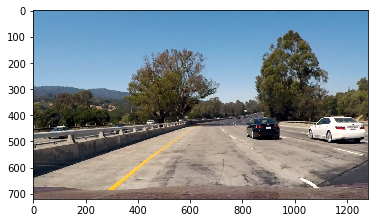

In [2]:
#read camera calibration
img = mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/test1.jpg')
plt.imshow(img)

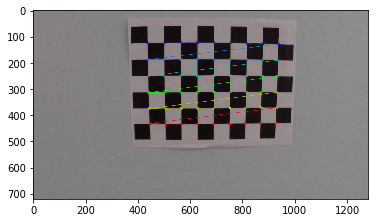

In [3]:
 
#read all images in the folder
images = glob.glob('../CarND-Advanced-Lane-Lines/camera_cal/*.jpg')

#arrays to store object points and image points
objectpoints = [] #3d 
imagepoints = [] #2d
global mtx
global dist


#preparing object points
objp = np.zeros((9*6,3),np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

for fname in images:
    img = cv2.imread(fname)
    #convert image to gray scale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

     # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

     # If found, add object points, image points
    if ret == True:
        #print('inside')
        objectpoints.append(objp)
        imagepoints.append(corners)
        #Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objectpoints, imagepoints, gray.shape[::-1], None, None)
        
plt.imshow(img)
    


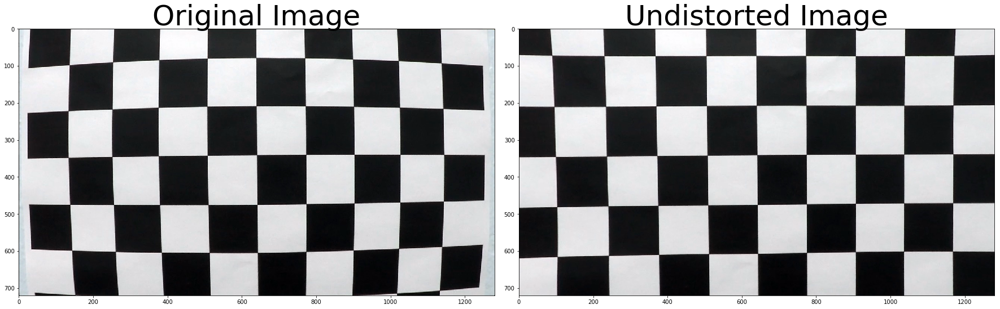

In [4]:
# Do camera calibration given object points and image points
#ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objectpoints, imagepoints, img,None,None)

#Undistort image
#dst = cv2.undistort(img,mtx,dist,None,mtx) 
# Read in an image
img = cv2.imread('../CarND-Advanced-Lane-Lines/camera_cal/calibration1.jpg')
#img = cv2.imread('../CarND-Advanced-Lane-Lines/test_images/test1.jpg')
def cal_undistort(img, objectpoints, imagepoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    #img = cv2.imread('../CarND-Advanced-Lane-Lines/test_images/*.jpg'+fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    #image = cv2.drawChessboardCorners(img, (9,6), corners, ret)
    undistd = cv2.undistort(img, mtx, dist, None, mtx)
    #print(undistd)
    #undistorted = undistort_image(img, mtx, dist)
    return undistd
undistorted = cal_undistort(img, objectpoints, imagepoints)
        
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        
        


In [5]:
# All the functions written based on the excerises done in the understanding level
# many of the functions taken from the exercise directly and modified according to the project needs
#Many comments says testing and at each level the code is written by understanding and testing

In [6]:
def save(dir, fname, img):
    fname = ''.join([dir,'undistorted_',fname])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    cv2.imwrite(fname,img)

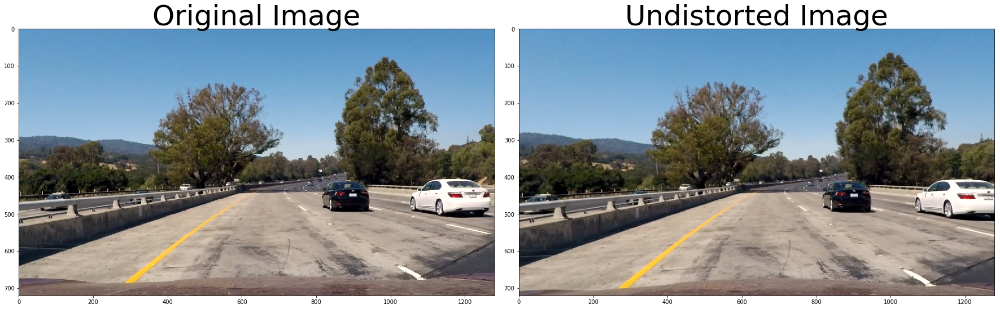

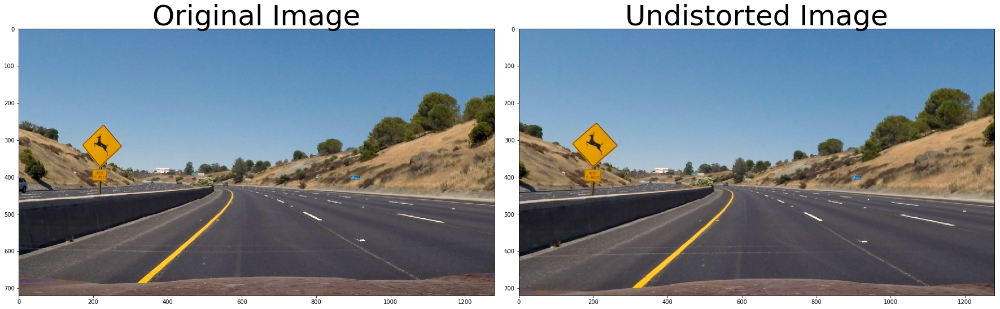

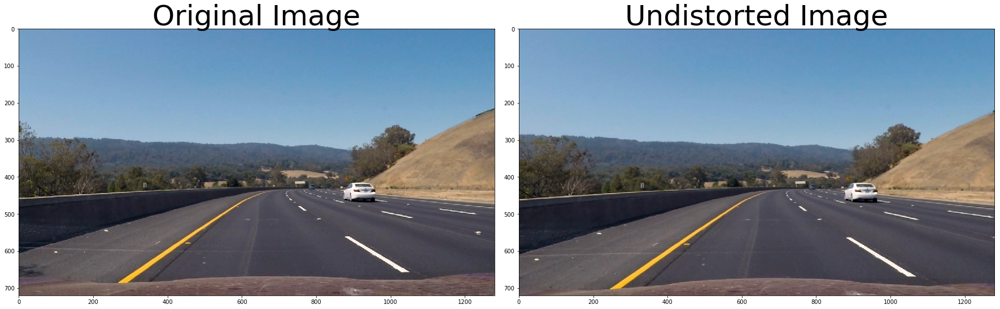

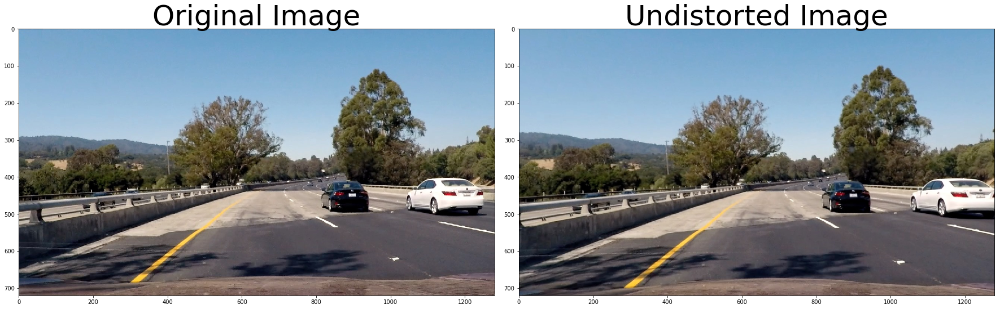

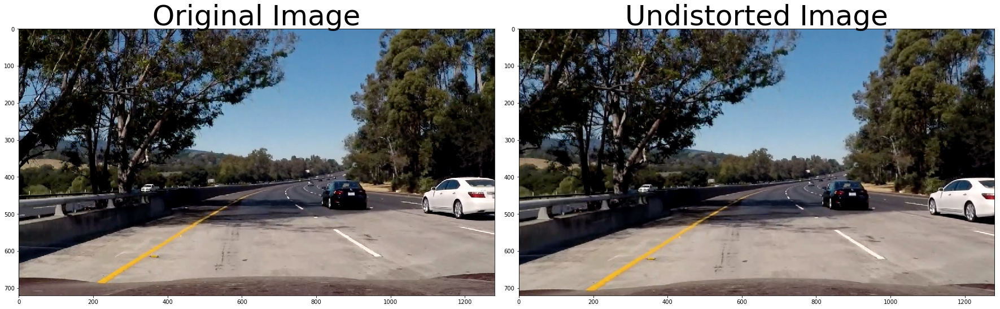

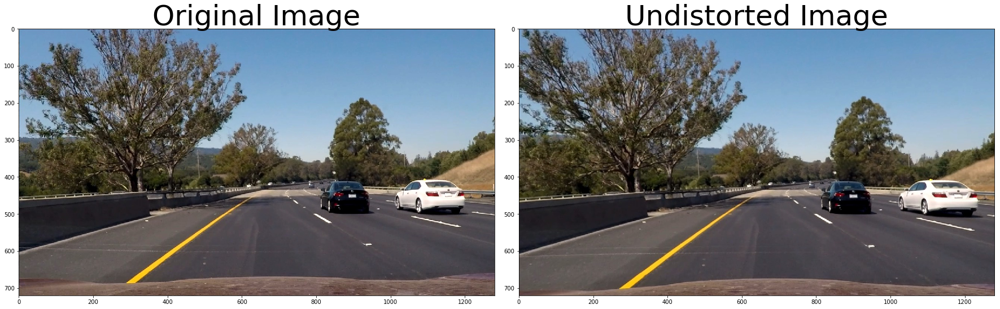

In [7]:
#Apply in lane images

images = ['test1.jpg', 'test2.jpg','test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']

for fname in images:
    img = cv2.imread('test_images/'+fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted = cal_undistort(img, mtx, dist)  
    
    #saving to a folder
    save('../CarND-Advanced-Lane-Lines/output_images/',fname,undistorted) 
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


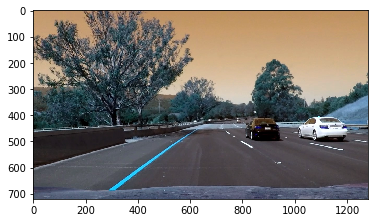

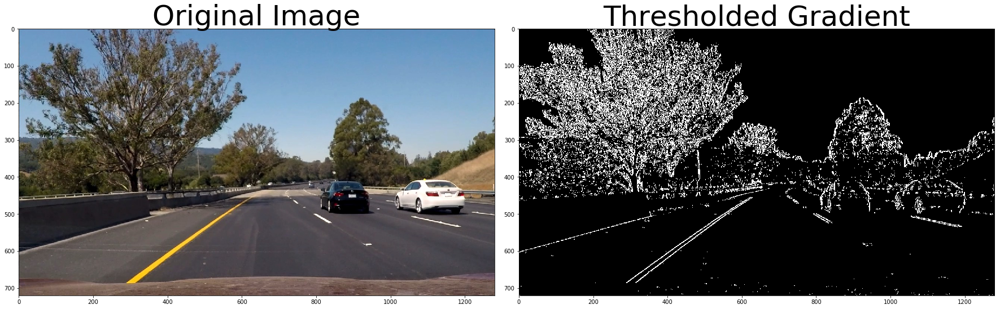

In [8]:
global thresh_min
global thresh_max
global grad_binary


#def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img) 
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    scaled_sobel = None
    sobel_kernel=3 
    # Sobel x
    if orient == 'x':
        #print('inside') 
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel) # Take the derivative in x
        #print(sobelx)
        abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
        scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
        
    # Sobel y
    else:
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel) # Take the derivative in y
        abs_sobely = np.absolute(sobely) # Absolute x derivative to accentuate lines away from horizontal
        scaled_sobel = np.uint8(255*abs_sobely/np.max(abs_sobely))

    # Threshold x gradient
    thresh_min = 20 
    thresh_max = 100 
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    return grad_binary

# Run the function
grad_binary = abs_sobel_thresh(img, orient='x', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)





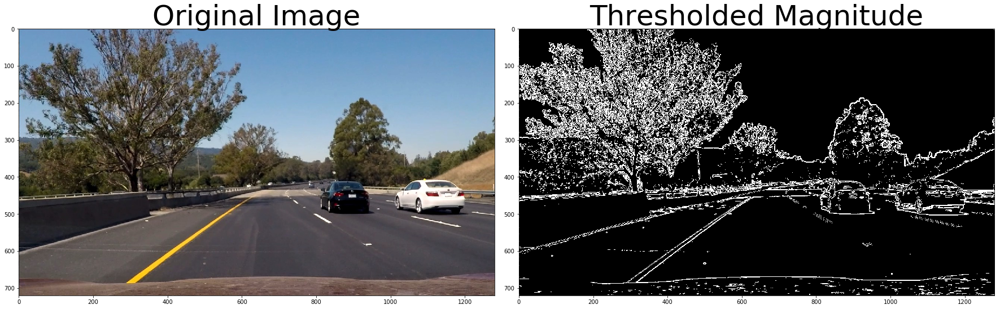

In [9]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    magnitude = np.sqrt(np.square(sobelx)+np.square(sobely))
    abs_magnitude = np.absolute(magnitude)
    scaled_magnitude = np.uint8(255*abs_magnitude/np.max(abs_magnitude))
    mag_binary = np.zeros_like(scaled_magnitude)
    mag_binary[(scaled_magnitude >= mag_thresh[0]) & (scaled_magnitude <= mag_thresh[1])] = 1
    
    return mag_binary


# Run the function
mag_binary = mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



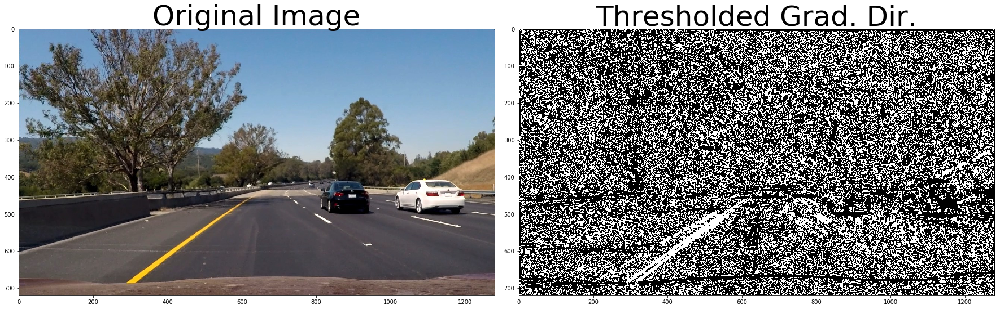

In [10]:
import numpy as np

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    arctan = np.arctan2(abs_sobely, abs_sobelx)
    #absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary = np.zeros_like(arctan)
    dir_binary[(arctan >= thresh[0]) & (arctan <= thresh[1])] = 1
    
    return dir_binary

# Run the function
dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



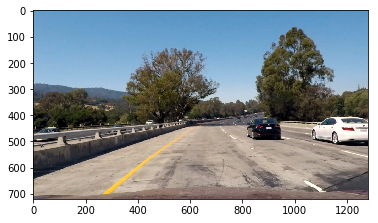

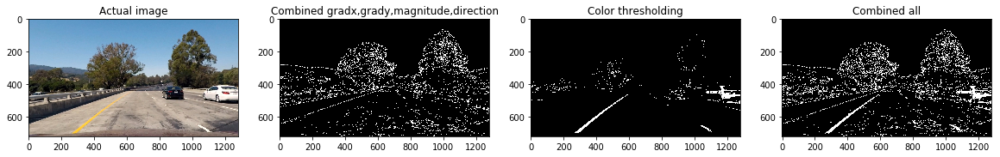

In [11]:

def combined_s_gradient_thresholds(img, show=False):

    # Choose a Sobel kernel size
    ksize = 3  # Choose a larger odd number to smooth gradient measurements
    #print(ksize) 

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(img, orient='x',thresh_min=20, thresh_max=100)
    grady = abs_sobel_thresh(img, orient='y',thresh_min=20, thresh_max=100)
    #print(gradx)
    #print(grady) 
    mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(20, 100))
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.4))

    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]

    # Threshold color channel
    s_thresh_min = 150
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(combined)
    
    combined_binary[(s_binary == 1) | (combined == 1)] = 1
    
    if show == True:
        #print('inside')
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20,10))
        ax1.set_title('Actual image')
        ax1.imshow(img)
        ax2.set_title('Combined gradx,grady,magnitude,direction')
        ax2.imshow(combined, cmap='gray')
        ax3.set_title('Color thresholding')
        ax3.imshow(s_binary, cmap='gray')
        ax4.set_title('Combined all')
        ax4.imshow(combined_binary, cmap='gray')
        
    return combined_binary

img = '../CarND-Advanced-Lane-Lines/output_images/undistorted_test1.jpg'
img = cv2.imread(img)
combined_binary_thresholds = combined_s_gradient_thresholds(img,True) 
 



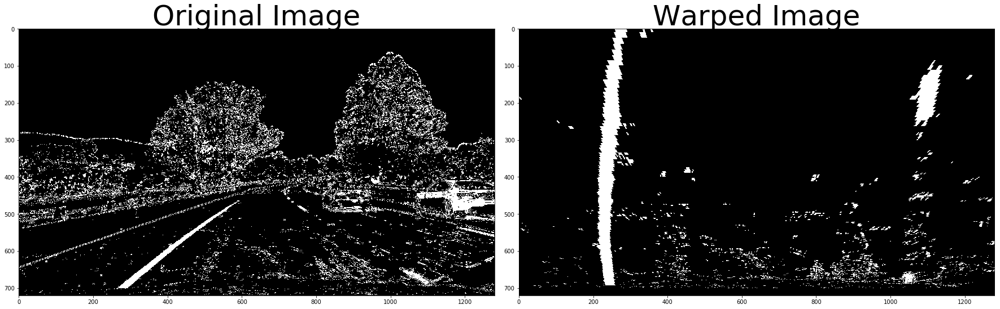

In [12]:

#Transform
def transform_image(img, nx, ny): 
    offset = 100 # offset for dst points
    
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
    
    leftupperpoint  = [568,470]
    rightupperpoint = [717,470]
    leftlowerpoint  = [260,680]
    rightlowerpoint = [1043,680]

    src = np.float32([leftupperpoint, leftlowerpoint, rightupperpoint, rightlowerpoint])
    dst = np.float32([[200,0], [200,680], [1000,0], [1000,680]])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)

    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)
    
    return warped, M

def visualize_transorm_image(combined_binary_thresholds, warped_img):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(combined_binary_thresholds, cmap='gray')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped_img,cmap='gray')
    ax2.set_title('Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

warped_img, M = transform_image(combined_binary_thresholds, 100, 100) 
visualize_transorm_image(combined_binary_thresholds, warped_img)


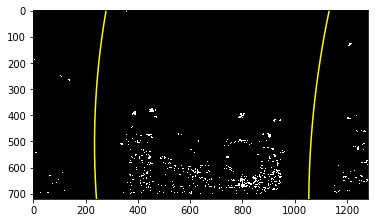

In [13]:
def find_lane_pixels(warped_img):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(warped_img[warped_img.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((warped_img, warped_img, warped_img))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(warped_img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped_img.shape[0] - (window+1)*window_height
        win_y_high = warped_img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    #####Adding polyfit here to test#####
     # Fit a second order polynomial to each
#     left_fit = np.polyfit(lefty, leftx, 2)
#     right_fit = np.polyfit(righty, rightx, 2)

    return leftx, lefty, rightx, righty,nonzerox,nonzeroy,out_img
#     #changing return
#return left_fit, right_fit,left_lane_inds, right_lane_inds, nonzerox, nonzeroy


def fit_polynomial(warped_img):
    # Find our lane pixels first
    #leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped_img)
    #left_fit, right_fit,left_lane_inds, right_lane_inds, nonzerox, nonzeroy = find_lane_pixels(warped_img)
    leftx, lefty, rightx, righty,nonzerox,nonzeroy,out_img = find_lane_pixels(warped_img) 

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    #print(left_fit)
    #print('right fit values from here')
    #print(right_fit)

    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img,left_fit,right_fit,left_fitx,right_fitx 


out_img,left_fit,right_fit,left_fitx,right_fitx = fit_polynomial(warped_img)

plt.imshow(out_img)

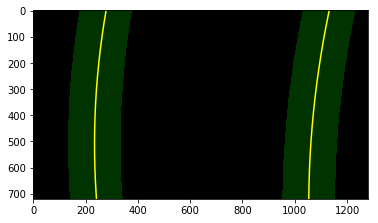

In [14]:
# Polynomial fit values from the previous frame


left_fit = np.array([1.69456265e-04,  -1.72848728e-01,  2.78505906e+02])  # do not forget to put comma 
right_fit = np.array([1.39790990e-04,  -2.08994878e-01,   1.13154984e+03])

def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, right_fit, ploty


def search_around_poly(warped_img):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = warped_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    #########################################
    if len(leftx) == 0:
        leftx_new = [] 
    else:
        # Fit new polynomials
        left_fitnx, right_fitnx, ploty = fit_poly(warped_img.shape, leftx, lefty, rightx, righty)
        
             
            
        
    if len(rightx) == 0:
        rightx_new = [] 
    else:
             # Fit new polynomials
        left_fitnx, right_fitnx, ploty = fit_poly(warped_img.shape, leftx, lefty, rightx, righty)
            
            
            
     ##########################################   
    
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((warped_img, warped_img, warped_img))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result,left_fitnx, right_fitnx 

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result,left_fitnx, right_fitnx = search_around_poly(warped_img)

# View your output
plt.imshow(result)

In [15]:

def generate_data(ym_per_pix, xm_per_pix):  # testing
    
    # Generate some  data from image  to represent lane-line pixels
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0])# to cover same y-range as image
    quadratic_coeff = 3e-4 # arbitrary quadratic coefficient

    leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])
    rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])

    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


    # Fit a second order polynomial to pixel positions in each lane line
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    return ploty, left_fit_cr, right_fit_cr
    
def measure_curvature_real():
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    ploty, left_fit_cr, right_fit_cr = generate_data(ym_per_pix, xm_per_pix)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad


# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad = measure_curvature_real()

print(left_curverad, 'm', right_curverad, 'm')



521.365945376 m 525.596458774 m


In [16]:
def radius_curvature(warped_img, left_fit, right_fit):
    
    #print(left_fit) 
    #print(right_fit)
    
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    y_eval = np.max(ploty)
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    # Calculate the new radius of curvature
    left_curvature =  ((1 + (2*left_fit_cr[0] *y_eval*ym_per_pix + left_fit_cr[1])**2) **1.5) / np.absolute(2*left_fit_cr[0])
    right_curvature = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Calculate vehicle center
    #left_lane and right lane bottom in pixels
    left_lane_bottom = (left_fit[0]*y_eval)**2 + left_fit[0]*y_eval + left_fit[2]
    right_lane_bottom = (right_fit[0]*y_eval)**2 + right_fit[0]*y_eval + right_fit[2]
    
    # Lane center calculation using left and right lane bottom                        
    lane_center = (left_lane_bottom + right_lane_bottom)/2.
    center_image = 640
    center = (lane_center - center_image)*xm_per_pix #Convert to meters
    position = "left" if center < 0 else "right"
    center = "Vehicle is {:.2f}m {}".format(center, position)
    
    # Now our radius of curvature is in meters
    return left_curvature, right_curvature, center 

In [17]:
left_curvature, right_curvature, center = radius_curvature(warped_img, left_fit, right_fit)
print(left_curvature)
print(right_curvature)
print(center) 

969.256670218
1174.80374726
Vehicle is 0.34m right


In [18]:
def show_on_image(undist, warped_img, left_fit, right_fit, M, left_curvature, right_curvature, center, show_values = False):
    plot_y = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0] )
    left_fitx = left_fit[0]*plot_y**2 + left_fit[1]*plot_y + left_fit[2]
    right_fitx = right_fit[0]*plot_y**2 + right_fit[1]*plot_y + right_fit[2]

    # Creating an image to show the lines on it
    warped_zero = np.zeros_like(warped_img).astype(np.uint8)
    colored_warped = np.dstack((warped_zero, warped_zero, warped_zero))

    # Rearrange the x pointsand  y points  for cv2.fillPoly()
    points_left = np.array([np.transpose(np.vstack([left_fitx, plot_y]))])
    points_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, plot_y])))])
    points = np.hstack((points_left, points_right))

    # show the lane onto the warped  image
    cv2.fillPoly(colored_warped, np.int_([points]), (0,255, 0))
    Minv = np.linalg.inv(M)
    #  Applying inverse perspective matrix 
    newly_warped = cv2.warpPerspective(colored_warped, Minv, (undist.shape[1], img.shape[0])) 
    # Applying with original image
    result_org = cv2.addWeighted(undist, 1, newly_warped, 0.3, 0)
    
    cv2.putText(result_org, 'Left curvature: {:.0f} m'.format(left_curvature), (50, 50), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
    cv2.putText(result_org, 'Right curvature: {:.0f} m'.format(right_curvature), (50, 100), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
    cv2.putText(result_org, '{}'.format(center), (50, 150), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
    if show_values == True:
        fig, ax = plt.subplots(figsize=(20, 10))
        ax.imshow(result_org)
        
    return result_org
# View your output
#plt.imshow(result_org) 

array([[[ 97, 153, 202],
        [ 97, 153, 202],
        [ 97, 153, 202],
        ..., 
        [ 87, 149, 196],
        [ 86, 148, 195],
        [ 85, 147, 194]],

       [[ 97, 153, 200],
        [ 97, 153, 200],
        [ 97, 153, 200],
        ..., 
        [ 87, 149, 196],
        [ 86, 148, 195],
        [ 85, 147, 194]],

       [[ 98, 154, 201],
        [ 98, 154, 201],
        [ 98, 154, 201],
        ..., 
        [ 87, 149, 196],
        [ 86, 148, 195],
        [ 85, 147, 194]],

       ..., 
       [[107,  91, 102],
        [107,  91, 102],
        [107,  91, 102],
        ..., 
        [126, 107, 100],
        [124, 105,  98],
        [121, 102,  95]],

       [[109,  93, 103],
        [109,  93, 103],
        [109,  93, 103],
        ..., 
        [125, 106,  99],
        [124, 105,  98],
        [124, 105,  98]],

       [[112,  96, 106],
        [111,  95, 105],
        [111,  94, 104],
        ..., 
        [127, 108, 102],
        [127, 110, 103],
        [127, 110,

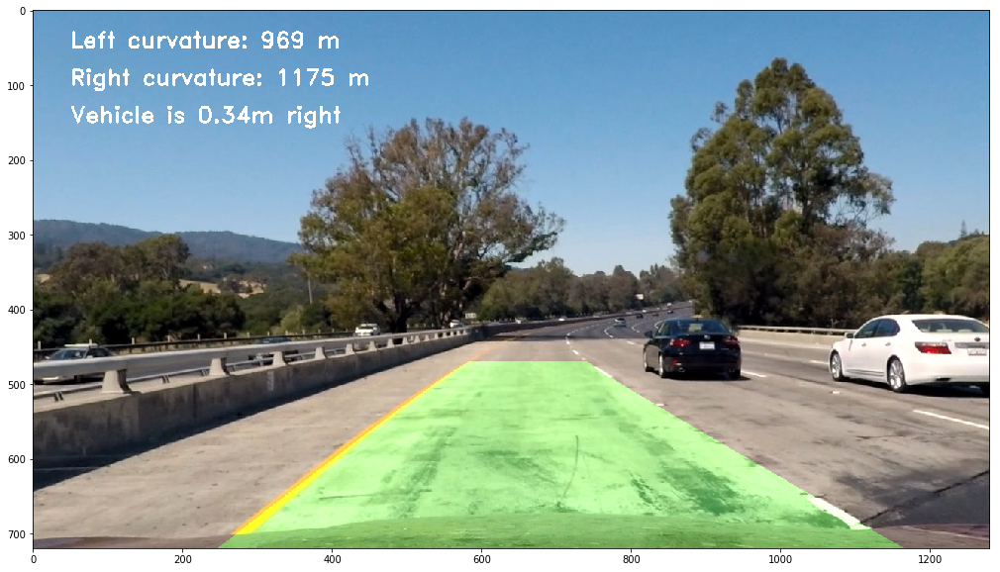

In [19]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
show_on_image(img, warped_img, left_fit, right_fit, M, left_curvature, right_curvature, center, True)

In [20]:
#for video processing and merging
def Check_valid_lane(left_fit, right_fit):
    
    #Check if vertical and horizontal fit co-ordinates return a value
    if len(left_fit) ==0 or len(right_fit) == 0:
        status_flag = False

    else:
        #Calculate the distance betweenw lines
        plot_y = np.linspace(0, 20, num=10 )
        left_fitx = left_fit[0]*plot_y**2 + left_fit[1]*plot_y + left_fit[2]
        right_fitx = right_fit[0]*plot_y**2 + right_fit[1]*plot_y + right_fit[2]
        lines_mean_val = np.mean(right_fitx - left_fitx)
        if lines_mean_val >= 150 and lines_mean_val <=430: 
            status_flag = True
        else:
            status_flag = False
        
        # Calculating slope of lanes for midpoint of vertical co-ordinates (720/2 is 360)
        left = 2*left_fit[0]*360+left_fit[1]
        right = 2*right_fit[0]*360+right_fit[1]
        slope_of_midpoint =  np.abs(left-right)
        
        #Flag lines are parallel at the middle
        if slope_of_midpoint <= 0.1:
            status_flag = True
        else:
            status_flag = False
            
    return status_flag

In [21]:
# characteristics of each line detection
#Defining class for the lane charcteristics helps in idntifying the lane variables and also to handle its values easily
class Lane_Charc():
    def __init__(prj):
        prj.right_fit = [] 
        prj.counter = 0
        prj.reset_counter = 0
        prj.last_left = []
        prj.last_right = []
        prj.left_fit = []
        
        



def Get_lane_vars(img):
    
    #img = cal_undistort(img, mtx, dist)
    ###for testing
    ima_g = cv2.undistort(img, mtx, dist, None, mtx)
    combined_binary = combined_s_gradient_thresholds(ima_g,True)
    plt.imshow(combined_binary) 
    warped_img, M = transform_image(combined_binary, 100, 100) 
    print(lane_charstcs.counter) 
    if lane_charstcs.counter == 0:
        print('inside')
        out_img,left_fit,right_fit,left_fitx,right_fitx = fit_polynomial(warped_img)
        print(left_fit)
        print(right_fit) 
        lane_charstcs.left_fit = left_fit
        lane_charstcs.right_fit = right_fit
    else:
        print('else')
        result,left_fitnx, right_fitnx = search_around_poly(warped_img)
        print(left_fitnx) 
        print(right_fitnx)
        lane_charstcs.left_fit = left_fitnx
        lane_charstcs.right_fit = right_fitnx 
    
    #Status check if the lane is valid or not
    status_check_valid_lane = Check_valid_lane(lane_charstcs.left_fit, lane_charstcs.right_fit)
    #print(status)
    
    if status_check_valid_lane == True:        
        lane_charstcs.last_left, lane_charstcs.last_right = lane_charstcs.left_fit, lane_charstcs.right_fit        
        lane_charstcs.counter += 1
        lane_charstcs.reset_counter = 0
    else:   
        #Reset
        if lane_charstcs.reset_counter > 4:
            lane_charstcs.left_fit, lane_charstcs.right_fit,left_lane_inds, right_lane_inds, nonzerox, nonzeroy,out_img = find_lane_pixels(warped_img)
            lane_charstcs.reset_counter = 0
        else:
            lane_charstcs.left_fit, lane_charstcs.right_fit = lane_charstcs.last_left, lane_charstcs.last_right
            
        lane_charstcs.reset_counter += 1
    
    return warped_img, lane_charstcs.left_fit, lane_charstcs.right_fit, M

#for testing
#warped_img, left_fit, right_fit, M = Get_lane_vars(img)
#plt.imshow(combined_binary) 



0
inside
[  8.98081564e-05  -2.30472341e-01   3.45302456e+02]
[  1.91410177e-04  -2.82389495e-01   1.14116439e+03]


array([[[183, 202, 208],
        [138, 158, 167],
        [127, 150, 166],
        ..., 
        [ 34,  71,  98],
        [  3,  35,  56],
        [ 18,  49,  67]],

       [[140, 160, 169],
        [137, 159, 172],
        [132, 157, 177],
        ..., 
        [ 90, 131, 161],
        [ 55,  91, 115],
        [  2,  34,  55]],

       [[131, 154, 170],
        [135, 160, 180],
        [121, 149, 173],
        ..., 
        [ 97, 141, 176],
        [ 92, 133, 163],
        [ 33,  73,  99]],

       ..., 
       [[131, 116, 113],
        [105,  90,  87],
        [ 98,  83,  80],
        ..., 
        [ 78,  67,  65],
        [ 91,  80,  78],
        [129, 118, 116]],

       [[147, 133, 130],
        [126, 111, 108],
        [105,  90,  87],
        ..., 
        [ 84,  73,  71],
        [119, 108, 106],
        [145, 134, 132]],

       [[155, 141, 138],
        [122, 108, 105],
        [113,  98,  95],
        ..., 
        [123, 112, 110],
        [142, 132, 130],
        [190, 180,

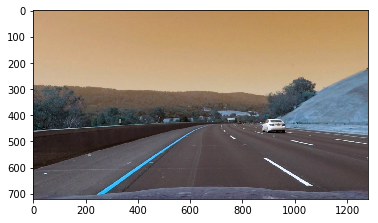

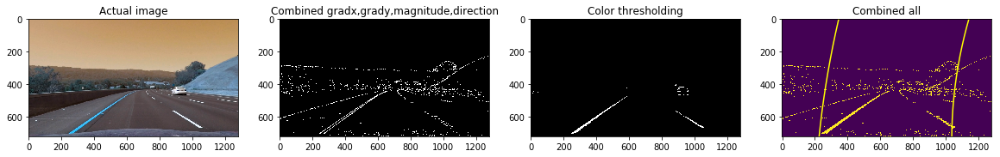

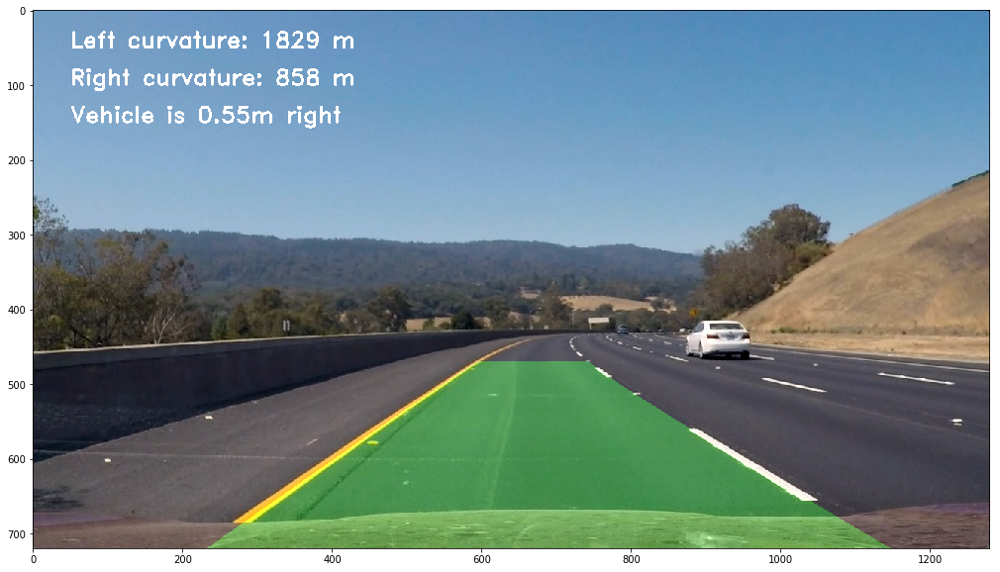

In [22]:
lane_charstcs = Lane_Charc() 
global Lane_Charc

def looping_images(img, show_values=False):
    #lane_charstcs = Lane_Charc() 
    #print(lane_charstcs.counter)  
    warped_img, left_fit, right_fit, M = Get_lane_vars(img)
    #print(left_fit) 
    #print(right_fit)
    left_curvature, right_curvature, center = radius_curvature(warped_img, left_fit, right_fit)
    #print(left_curvature) 
    
    return show_on_image(img, warped_img, left_fit, right_fit, M, left_curvature, right_curvature, center, show_values)
    
images = ['test1.jpg', 'test2.jpg','test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']

######testing 
img = cv2.imread('test_images/test3.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
looping_images(img, True)
##########################


1
else
[  1.98596937e-04  -1.92469948e-01   2.80718067e+02]
[  1.53040317e-04  -2.18866113e-01   1.13496295e+03]
2
else
[ -1.58145612e-04   2.33836415e-01   1.90255047e+02]
[ -2.05118879e-04   1.43335457e-01   1.02174421e+03]
2
else
[  9.17467298e-05  -2.28944615e-01   3.44085652e+02]
[  2.00849721e-04  -2.88418735e-01   1.14180539e+03]
3
else
[ -1.49336793e-06  -3.49309598e-02   2.72538210e+02]
[  4.32325434e-04  -4.17311092e-01   1.16844467e+03]
4
else
[  4.91324343e-04  -5.00978825e-01   3.00435291e+02]
[ -2.99681479e-04   1.15898005e-01   1.08269315e+03]
5
else
[ -1.67305107e-05  -1.15303580e-01   3.33830783e+02]
[  3.34814210e-05  -1.67194602e-01   1.16333406e+03]


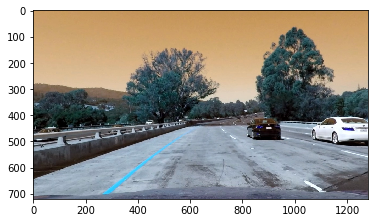

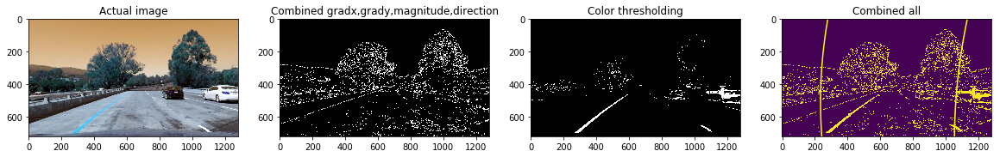

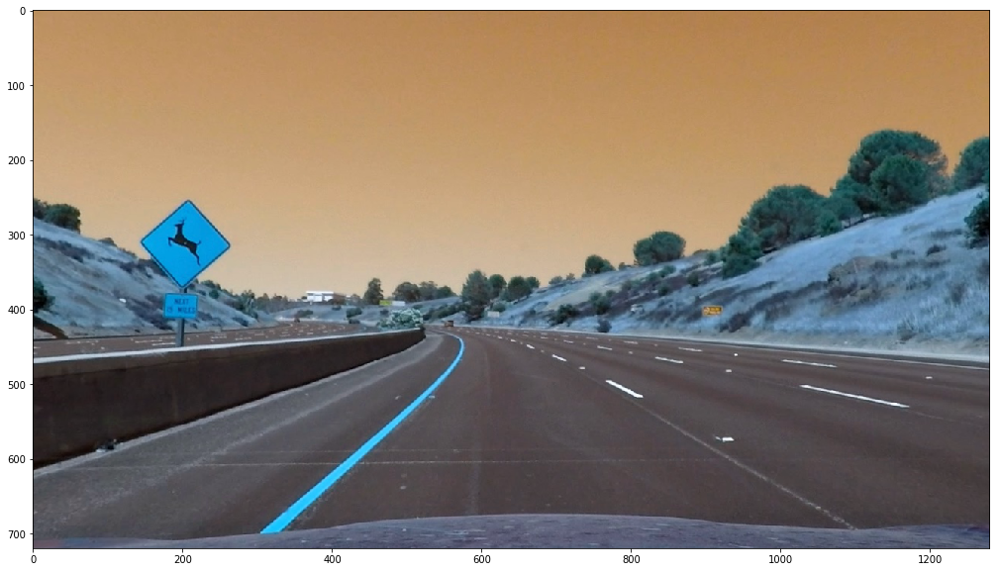

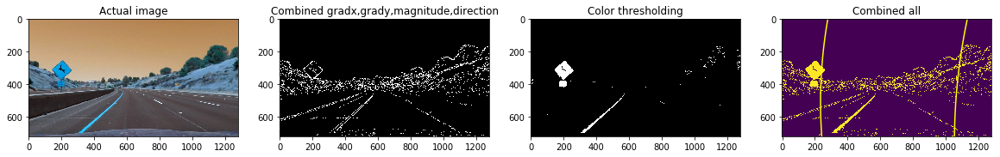

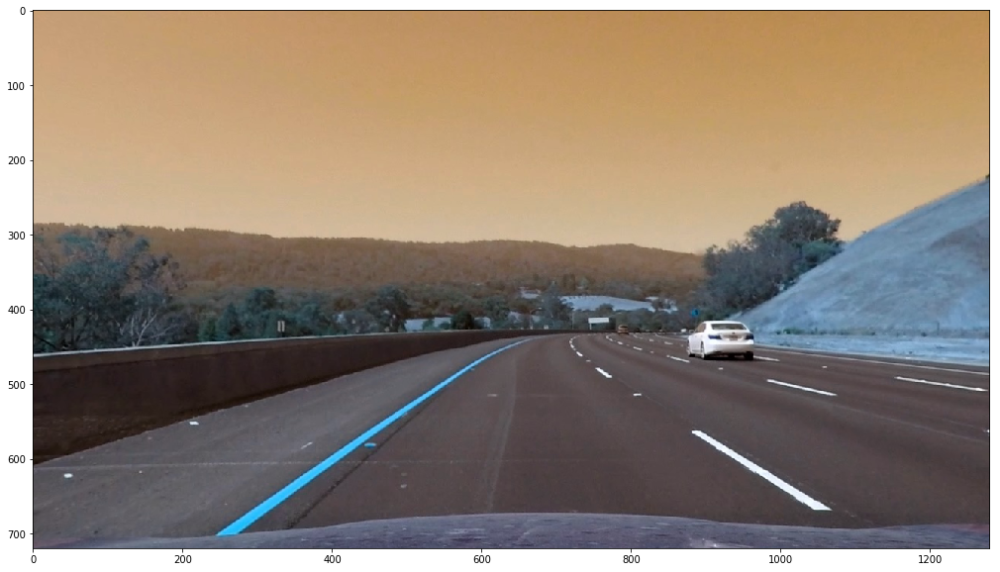

...

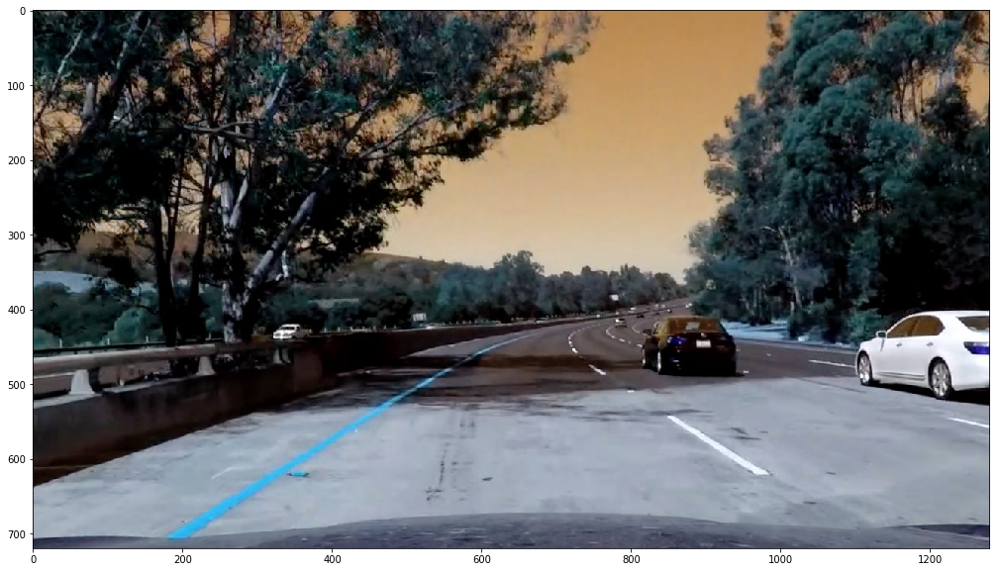

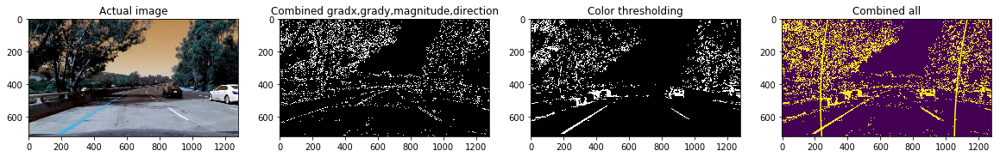

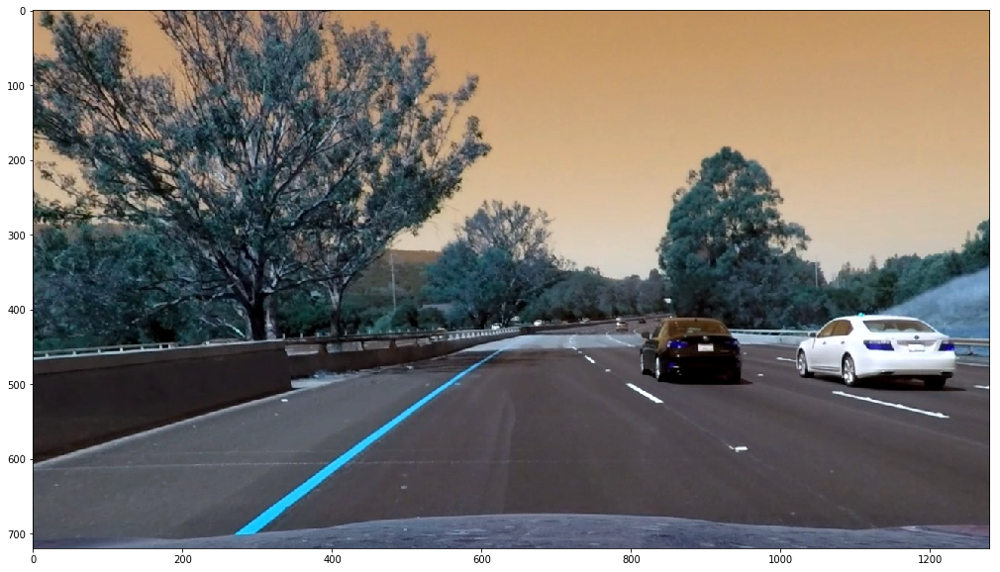

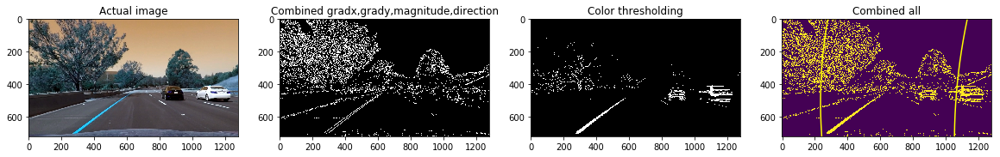

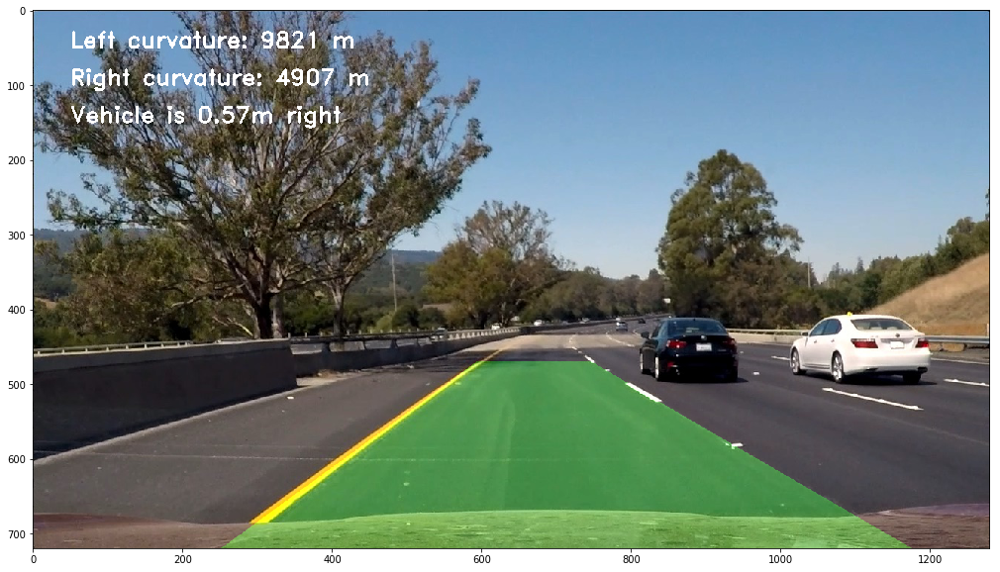

In [23]:
for fname in images:
    img = cv2.imread('test_images/'+fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    looping_images(img, True)

In [24]:
# Accessing the libs watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
lane_charstcs = Lane_Charc()
global Lane_Charc 
def process_image(img):
    return looping_images(img) 

real_output = 'output_images/project_video.mp4'
clip1 = VideoFileClip("project_video.mp4")
real_clip = clip1.fl_image(process_image)
%time real_clip.write_videofile(real_output, audio=False)

0
inside
[ -1.57712704e-04   2.30594795e-01   1.88563341e+02]
[ -1.19725245e-04   2.13089999e-01   9.95028945e+02]
[MoviePy] >>>> Building video output_images/project_video.mp4
[MoviePy] Writing video output_images/project_video.mp4


  0%|          | 1/1261 [00:00<11:40,  1.80it/s]

1
else
[ -1.71879872e-04   2.28304417e-01   1.90769667e+02]
[ -7.24024162e-05   1.26975334e-01   1.02560141e+03]


  0%|          | 2/1261 [00:01<11:29,  1.83it/s]

2
else
[ -1.88263943e-04   2.42347618e-01   1.89696279e+02]
[ -9.20690923e-05   1.50183213e-01   1.01676321e+03]


  0%|          | 3/1261 [00:01<11:18,  1.85it/s]

3
else
[ -2.18728667e-04   2.64639832e-01   1.87793570e+02]
[  4.23879121e-05   6.85382412e-02   1.01807074e+03]


  0%|          | 4/1261 [00:02<11:06,  1.89it/s]

4
else
[ -2.46403885e-04   2.87648478e-01   1.84829293e+02]
[  7.10679517e-05   5.25833589e-02   1.01530766e+03]


  0%|          | 5/1261 [00:02<11:03,  1.89it/s]

5
else
[ -2.32213572e-04   2.85737941e-01   1.83792266e+02]
[  1.45739162e-04  -1.09930063e-02   1.02456970e+03]


  0%|          | 6/1261 [00:03<11:02,  1.89it/s]

6
else
[ -2.02422026e-04   2.72011649e-01   1.83750453e+02]
[  2.69230330e-05   9.79674892e-02   1.00142856e+03]


  1%|          | 7/1261 [00:03<11:02,  1.89it/s]

7
else
[ -1.78410507e-04   2.62082866e-01   1.81689578e+02]
[ -6.06049037e-06   1.18307507e-01   1.00132827e+03]


  1%|          | 8/1261 [00:04<11:04,  1.89it/s]

8
else
[ -1.70083248e-04   2.58040724e-01   1.83255667e+02]
[  5.16365472e-05   5.43560546e-02   1.01279129e+03]


  1%|          | 9/1261 [00:04<11:06,  1.88it/s]

9
else
[ -1.12187489e-04   2.17656005e-01   1.85557259e+02]
[  1.98625108e-06   9.69041361e-02   1.00864212e+03]


  1%|          | 10/1261 [00:05<11:52,  1.76it/s]

10
else
[ -1.19744900e-04   2.27632894e-01   1.81685294e+02]
[ -3.22941167e-05   1.20695343e-01   1.00608550e+03]


  1%|          | 11/1261 [00:05<11:36,  1.80it/s]

11
else
[ -1.25710581e-04   2.35170343e-01   1.79191506e+02]
[ -1.48508919e-04   2.47370668e-01   9.72693896e+02]


  1%|          | 12/1261 [00:06<11:27,  1.82it/s]

12
else
[ -1.00098358e-04   2.20778753e-01   1.75472592e+02]
[ -3.06290224e-04   3.89544965e-01   9.48593752e+02]


  1%|          | 13/1261 [00:07<11:18,  1.84it/s]

13
else
[ -1.16742560e-04   2.35202611e-01   1.72621843e+02]
[ -4.59069848e-05   1.53665038e-01   9.98062168e+02]


  1%|          | 14/1261 [00:07<11:15,  1.85it/s]

14
else
[ -1.52676455e-04   2.64808256e-01   1.66632803e+02]
[  5.85148332e-05   7.25976299e-02   1.01040568e+03]


  1%|          | 15/1261 [00:08<11:11,  1.85it/s]

15
else
[ -1.72283763e-04   2.75625436e-01   1.67828840e+02]
[  4.22077879e-05   9.84867157e-02   9.95064254e+02]


  1%|▏         | 16/1261 [00:08<11:10,  1.86it/s]

16
else
[ -1.74252757e-04   2.78741340e-01   1.67673804e+02]
[  1.11189982e-04   4.55593441e-02   9.95768187e+02]


  1%|▏         | 17/1261 [00:09<11:06,  1.87it/s]

17
else
[ -1.61659398e-04   2.73973932e-01   1.65870625e+02]
[  1.37937558e-04   2.25964919e-02   9.97046472e+02]


  1%|▏         | 18/1261 [00:09<11:01,  1.88it/s]

18
else
[ -1.20720476e-04   2.47653021e-01   1.67911045e+02]
[  2.57259390e-04  -8.33418327e-02   1.01177240e+03]


  2%|▏         | 19/1261 [00:10<11:02,  1.87it/s]

19
else
[ -1.00714499e-04   2.34607627e-01   1.66044692e+02]
[  2.35533587e-04  -7.24942718e-02   1.01293585e+03]


  2%|▏         | 20/1261 [00:10<11:01,  1.88it/s]

20
else
[ -8.10328533e-05   2.25602756e-01   1.63590249e+02]
[  2.10509280e-04  -6.24402785e-02   1.01522835e+03]


  2%|▏         | 21/1261 [00:11<11:01,  1.87it/s]

21
else
[ -4.34128823e-05   1.97082148e-01   1.64432095e+02]
[  1.73834936e-04  -5.11940549e-02   1.02159678e+03]


  2%|▏         | 22/1261 [00:11<11:46,  1.75it/s]

22
else
[ -1.30558649e-06   1.67928244e-01   1.63951149e+02]
[  7.04649435e-05   2.58118706e-02   1.01539608e+03]


  2%|▏         | 23/1261 [00:12<11:28,  1.80it/s]

23
else
[  5.16628263e-05   1.24550615e-01   1.67816166e+02]
[  3.82470402e-06   7.82322978e-02   1.01029578e+03]


  2%|▏         | 24/1261 [00:12<11:16,  1.83it/s]

24
else
[  5.70052691e-05   1.08081461e-01   1.73977987e+02]
[ -7.58242176e-05   1.58073576e-01   9.90428655e+02]


  2%|▏         | 25/1261 [00:13<11:10,  1.84it/s]

25
else
[  1.06479267e-05   1.36198471e-01   1.71836242e+02]
[ -1.44415471e-04   2.36394010e-01   9.68671975e+02]


  2%|▏         | 26/1261 [00:14<11:02,  1.86it/s]

26
else
[  1.83649609e-05   1.26966221e-01   1.71399937e+02]
[  4.64953951e-05   6.02461678e-02   1.01203395e+03]


  2%|▏         | 27/1261 [00:14<10:56,  1.88it/s]

27
else
[ -2.38055988e-05   1.55300375e-01   1.67589601e+02]
[  3.22583126e-05   5.87304036e-02   1.01807317e+03]


  2%|▏         | 28/1261 [00:15<10:52,  1.89it/s]

28
else
[ -2.13298669e-05   1.51136702e-01   1.65840920e+02]
[  4.22019282e-05   4.46892513e-02   1.02707062e+03]


  2%|▏         | 29/1261 [00:15<10:50,  1.89it/s]

29
else
[ -5.43786940e-05   1.72499839e-01   1.65648944e+02]
[  7.94011578e-05   2.94578602e-02   1.02091533e+03]


  2%|▏         | 30/1261 [00:16<10:49,  1.89it/s]

30
else
[ -7.59542101e-05   1.85513455e-01   1.67185152e+02]
[  1.58535225e-04  -3.10792144e-02   1.02374241e+03]


  2%|▏         | 31/1261 [00:16<10:52,  1.89it/s]

31
else
[ -1.19071533e-04   2.13723515e-01   1.67032297e+02]
[  1.62710117e-04  -3.16817882e-02   1.01953577e+03]


  3%|▎         | 32/1261 [00:17<10:53,  1.88it/s]

32
else
[ -1.40299686e-04   2.24616303e-01   1.69934114e+02]
[  1.69556600e-04  -3.55320780e-02   1.01435724e+03]


  3%|▎         | 33/1261 [00:17<11:41,  1.75it/s]

33
else
[ -1.22780887e-04   2.13285435e-01   1.69495688e+02]
[ -6.51842599e-05   1.58271422e-01   9.84551081e+02]


  3%|▎         | 34/1261 [00:18<11:22,  1.80it/s]

34
else
[ -9.40463314e-05   1.87971734e-01   1.76544519e+02]
[  2.85221197e-06   7.91742649e-02   1.00327208e+03]


  3%|▎         | 35/1261 [00:18<11:11,  1.83it/s]

35
else
[ -8.90110573e-05   1.84700688e-01   1.77943897e+02]
[ -4.61973320e-05   1.20173239e-01   9.97033034e+02]


  3%|▎         | 36/1261 [00:19<11:03,  1.85it/s]

36
else
[ -1.18272502e-04   2.06116602e-01   1.77539520e+02]
[ -6.73922864e-05   1.55875972e-01   9.85454793e+02]


  3%|▎         | 37/1261 [00:19<11:02,  1.85it/s]

37
else
[ -1.43515656e-04   2.23370737e-01   1.76566700e+02]
[ -1.05318285e-04   2.10409665e-01   9.69070708e+02]


  3%|▎         | 38/1261 [00:20<10:57,  1.86it/s]

38
else
[ -1.69979960e-04   2.43287370e-01   1.75662839e+02]
[ -2.91247737e-04   3.85139159e-01   9.28066011e+02]


  3%|▎         | 39/1261 [00:21<10:53,  1.87it/s]

39
else
[ -2.06042668e-04   2.70371747e-01   1.73265305e+02]
[ -3.39331116e-04   4.51968412e-01   9.04389614e+02]


  3%|▎         | 40/1261 [00:21<10:50,  1.88it/s]

40
else
[ -2.14914852e-04   2.81692152e-01   1.70043576e+02]
[  2.49200770e-06   1.20169169e-01   9.84095738e+02]


  3%|▎         | 41/1261 [00:22<10:46,  1.89it/s]

41
else
[ -2.21586424e-04   2.90767628e-01   1.68379356e+02]
[  5.99476317e-05   8.03947932e-02   9.87874072e+02]


  3%|▎         | 42/1261 [00:22<10:45,  1.89it/s]

42
else
[ -2.20406257e-04   2.97127527e-01   1.65817111e+02]
[  3.85127159e-05   8.68585907e-02   9.91448307e+02]


  3%|▎         | 43/1261 [00:23<12:28,  1.63it/s]

43
else
[ -1.99613653e-04   2.88025978e-01   1.64809708e+02]
[  1.30523482e-04   1.23281616e-02   1.00321440e+03]


  3%|▎         | 44/1261 [00:24<12:21,  1.64it/s]

44
else
[ -1.95767503e-04   2.90693516e-01   1.60679520e+02]
[  2.27980780e-04  -8.18851133e-02   1.02233702e+03]


  4%|▎         | 45/1261 [00:24<12:26,  1.63it/s]

45
else
[ -1.89623094e-04   2.91730055e-01   1.57874768e+02]
[  8.81558001e-05   3.36979122e-02   1.00476014e+03]


  4%|▎         | 46/1261 [00:25<13:34,  1.49it/s]

46
else
[ -1.77893830e-04   2.85794874e-01   1.56860506e+02]
[ -1.25855078e-04   2.05784360e-01   9.74226469e+02]


  4%|▎         | 47/1261 [00:26<13:07,  1.54it/s]

47
else
[ -1.58039088e-04   2.72692610e-01   1.56474767e+02]
[ -2.60731498e-05   8.77132856e-02   1.00581863e+03]


  4%|▍         | 48/1261 [00:26<12:50,  1.57it/s]

48
else
[ -1.31988696e-04   2.52978909e-01   1.59383509e+02]
[ -9.20006981e-05   1.61896300e-01   9.87942508e+02]


  4%|▍         | 49/1261 [00:27<12:41,  1.59it/s]

49
else
[ -1.01831593e-04   2.32526514e-01   1.58950278e+02]
[ -1.22797503e-04   1.89824549e-01   9.87501402e+02]


  4%|▍         | 50/1261 [00:27<12:24,  1.63it/s]

50
else
[ -1.24310658e-04   2.56757372e-01   1.53401438e+02]
[ -2.43955425e-04   3.20114855e-01   9.54922450e+02]


  4%|▍         | 51/1261 [00:28<12:31,  1.61it/s]

51
else
[ -1.21358677e-04   2.53704371e-01   1.53568441e+02]
[ -3.87518980e-04   4.50299299e-01   9.26029026e+02]


  4%|▍         | 52/1261 [00:29<12:16,  1.64it/s]

52
else
[ -1.70615168e-04   2.93915015e-01   1.47023783e+02]
[ -1.73615950e-04   2.61266993e-01   9.63649123e+02]


  4%|▍         | 53/1261 [00:29<12:28,  1.61it/s]

53
else
[ -1.77788385e-04   3.00567832e-01   1.45943873e+02]
[ -5.68541432e-05   1.62458013e-01   9.82057839e+02]


  4%|▍         | 54/1261 [00:30<12:19,  1.63it/s]

54
else
[ -1.67453820e-04   2.96765480e-01   1.44576589e+02]
[ -8.52058658e-05   2.00787931e-01   9.68099427e+02]


  4%|▍         | 55/1261 [00:30<12:28,  1.61it/s]

55
else
[ -1.33610759e-04   2.74698334e-01   1.45074435e+02]
[  4.22292568e-05   8.79171982e-02   9.88872473e+02]


  4%|▍         | 56/1261 [00:31<12:16,  1.64it/s]

56
else
[ -1.09681535e-04   2.58650615e-01   1.45302580e+02]
[  1.09794877e-04   2.82734901e-02   9.98003056e+02]


  5%|▍         | 57/1261 [00:32<12:23,  1.62it/s]

57
else
[ -8.28623150e-05   2.37513871e-01   1.48087154e+02]
[  1.97873049e-04  -5.21677657e-02   1.01118285e+03]


  5%|▍         | 58/1261 [00:32<12:11,  1.64it/s]

58
else
[ -5.45706106e-05   2.15765538e-01   1.50201224e+02]
[  1.58451999e-05   8.37401782e-02   9.88975788e+02]


  5%|▍         | 59/1261 [00:33<12:21,  1.62it/s]

59
else
[  4.42620711e-06   1.58612518e-01   1.63206180e+02]
[ -1.36350034e-04   2.30638646e-01   9.51420304e+02]


  5%|▍         | 60/1261 [00:33<12:10,  1.64it/s]

60
else
[  3.01115600e-05   1.32865567e-01   1.69770927e+02]
[ -4.40445814e-05   1.82063572e-01   9.50929469e+02]


  5%|▍         | 61/1261 [00:34<12:18,  1.63it/s]

61
else
[ -4.89048577e-07   1.49308501e-01   1.68753474e+02]
[ -5.52440118e-05   1.80557731e-01   9.52047373e+02]


  5%|▍         | 62/1261 [00:35<12:23,  1.61it/s]

62
else
[ -1.64528409e-05   1.52102356e-01   1.71639827e+02]
[  2.51112630e-05   1.09560695e-01   9.66693476e+02]


  5%|▍         | 63/1261 [00:36<13:36,  1.47it/s]

63
else
[ -2.78263871e-05   1.58959830e-01   1.69541276e+02]
[ -5.75895124e-05   1.66788902e-01   9.60438322e+02]


  5%|▌         | 64/1261 [00:36<13:20,  1.49it/s]

64
else
[ -6.19098394e-05   1.77848508e-01   1.69624984e+02]
[ -1.51402831e-04   2.73055749e-01   9.30650602e+02]


  5%|▌         | 65/1261 [00:37<12:52,  1.55it/s]

65
else
[ -6.63985314e-05   1.79983558e-01   1.68061851e+02]
[ -2.14901496e-04   3.87320900e-01   8.89592182e+02]


  5%|▌         | 66/1261 [00:37<12:51,  1.55it/s]

65
else
[ -1.07356754e-04   2.06843301e-01   1.66413376e+02]
[  7.41568868e-05   6.79257052e-02   9.75154997e+02]


  5%|▌         | 67/1261 [00:38<12:31,  1.59it/s]

66
else
[ -1.11159265e-04   2.07658768e-01   1.65944164e+02]
[  7.39447651e-05   5.83955751e-02   9.78797490e+02]


  5%|▌         | 68/1261 [00:39<12:31,  1.59it/s]

67
else
[ -1.09248212e-04   2.10039118e-01   1.62609483e+02]
[  1.29621769e-04   9.00150899e-03   9.87540948e+02]


  5%|▌         | 69/1261 [00:39<12:16,  1.62it/s]

68
else
[ -1.24340952e-04   2.16880581e-01   1.63906793e+02]
[  1.58989233e-04  -1.51483440e-02   9.87151167e+02]


  6%|▌         | 70/1261 [00:40<12:18,  1.61it/s]

69
else
[ -1.20153864e-04   2.17099691e-01   1.60291482e+02]
[  2.95224492e-04  -1.52384968e-01   1.01744714e+03]


  6%|▌         | 71/1261 [00:40<12:06,  1.64it/s]

70
else
[ -8.46019873e-05   1.88985764e-01   1.64825279e+02]
[  4.33185359e-04  -2.86654761e-01   1.04533282e+03]


  6%|▌         | 72/1261 [00:41<12:05,  1.64it/s]

70
else
[ -7.76440832e-05   1.87495830e-01   1.62144059e+02]
[  4.84151456e-04  -3.40282072e-01   1.05992058e+03]


  6%|▌         | 73/1261 [00:42<12:21,  1.60it/s]

70
else
[ -3.25724056e-05   1.50581426e-01   1.66817834e+02]
[  3.24130498e-04  -1.92969181e-01   1.03014543e+03]


  6%|▌         | 74/1261 [00:42<12:21,  1.60it/s]

71
else
[ -7.49863234e-06   1.32752319e-01   1.67884101e+02]
[  2.66608609e-04  -1.53172124e-01   1.02459608e+03]


  6%|▌         | 75/1261 [00:43<12:05,  1.64it/s]

72
else
[ -4.92132274e-06   1.36331792e-01   1.63106553e+02]
[  1.95265261e-04  -9.24061622e-02   1.01623727e+03]


  6%|▌         | 76/1261 [00:44<12:16,  1.61it/s]

73
else
[ -2.68396900e-05   1.52620745e-01   1.60658091e+02]
[  8.36392751e-05   1.98960827e-03   9.97191340e+02]


  6%|▌         | 77/1261 [00:44<12:13,  1.61it/s]

74
else
[  5.76032665e-06   1.33857609e-01   1.57317895e+02]
[ -6.59349153e-05   1.43093880e-01   9.70947051e+02]


  6%|▌         | 78/1261 [00:45<12:27,  1.58it/s]

75
else
[  2.27608027e-05   1.21938499e-01   1.56708960e+02]
[  7.52339004e-05   1.20554652e-02   1.00136159e+03]


  6%|▋         | 79/1261 [00:45<12:21,  1.59it/s]

76
else
[  2.24100660e-05   1.20552320e-01   1.54196385e+02]
[  6.99842149e-05   6.56310096e-03   1.00763162e+03]


  6%|▋         | 80/1261 [00:46<12:30,  1.57it/s]

77
else
[  1.33178295e-05   1.27156492e-01   1.52272425e+02]
[  7.45433278e-05   4.90487198e-03   1.00563552e+03]


  6%|▋         | 81/1261 [00:47<12:37,  1.56it/s]

78
else
[  4.71114177e-05   9.83406279e-02   1.57823046e+02]
[  1.16356578e-04  -2.48983366e-02   1.00572200e+03]


  7%|▋         | 82/1261 [00:47<12:23,  1.59it/s]

79
else
[  5.94508101e-05   8.67042288e-02   1.57852891e+02]
[  2.15128878e-04  -1.13530626e-01   1.02130985e+03]


  7%|▋         | 83/1261 [00:48<14:00,  1.40it/s]

80
else
[  6.14403562e-05   8.08344530e-02   1.58344052e+02]
[  2.11313026e-04  -1.04700300e-01   1.01953454e+03]


  7%|▋         | 84/1261 [00:49<13:36,  1.44it/s]

81
else
[  8.85385014e-05   5.96568056e-02   1.57162892e+02]
[  9.94709184e-05  -6.80046253e-03   1.00670931e+03]


  7%|▋         | 85/1261 [00:50<13:11,  1.49it/s]

82
else
[  1.10835978e-04   3.60725864e-02   1.62528332e+02]
[  1.33697176e-04  -4.38861910e-02   1.01761900e+03]
83
else
[  1.11998668e-04   2.63060937e-02   1.67148401e+02]
[  6.13919060e-05   1.78553993e-02   1.00650500e+03]


  7%|▋         | 87/1261 [00:51<13:43,  1.42it/s]

84
else
[  8.80461663e-05   3.37151756e-02   1.74478812e+02]
[  9.11720916e-05   1.69400444e-02   9.96096402e+02]


  7%|▋         | 88/1261 [00:52<13:35,  1.44it/s]

85
else
[  2.82514481e-05   6.95632895e-02   1.75391193e+02]
[  2.44729015e-05   6.33671180e-02   9.86300455e+02]


  7%|▋         | 89/1261 [00:52<13:30,  1.45it/s]

86
else
[ -2.21034189e-05   1.03421658e-01   1.74254911e+02]
[  4.02856475e-05   7.22948124e-02   9.76474208e+02]


  7%|▋         | 90/1261 [00:53<13:27,  1.45it/s]

87
else
[ -8.58557880e-05   1.42238995e-01   1.76265965e+02]
[  1.08719046e-05   1.11229983e-01   9.60247081e+02]
88
else
[ -9.29766295e-05   1.49125542e-01   1.74361837e+02]
[  2.57824065e-05   1.04965395e-01   9.60441491e+02]


  7%|▋         | 92/1261 [00:54<13:18,  1.46it/s]

89
else
[ -9.65209437e-05   1.54943797e-01   1.73020843e+02]
[  9.27904345e-05   1.13470756e-02   9.92166476e+02]


  7%|▋         | 93/1261 [00:55<13:09,  1.48it/s]

90
else
[ -1.07130831e-04   1.65647137e-01   1.74056178e+02]
[  1.91178559e-04  -7.22514307e-02   1.00325718e+03]


  7%|▋         | 94/1261 [00:56<13:21,  1.46it/s]

91
else
[ -1.21083879e-04   1.77090307e-01   1.73990113e+02]
[  2.46963871e-04  -1.25081628e-01   1.01319113e+03]


  8%|▊         | 95/1261 [00:56<13:12,  1.47it/s]

92
else
[ -1.02247235e-04   1.69370658e-01   1.72535088e+02]
[  2.82450491e-04  -1.68821660e-01   1.02321441e+03]


  8%|▊         | 96/1261 [00:57<13:00,  1.49it/s]

93
else
[ -8.65374030e-05   1.59119044e-01   1.74014553e+02]
[  4.18953640e-04  -2.77618205e-01   1.04435674e+03]


  8%|▊         | 97/1261 [00:58<12:57,  1.50it/s]

94
else
[ -7.16279930e-05   1.48642705e-01   1.75782604e+02]
[  2.81057986e-04  -1.62209712e-01   1.02187254e+03]


  8%|▊         | 98/1261 [00:58<12:53,  1.50it/s]

95
else
[ -5.33852934e-05   1.38325574e-01   1.74681878e+02]
[  2.43334752e-04  -1.31520374e-01   1.02010297e+03]


  8%|▊         | 99/1261 [00:59<12:40,  1.53it/s]

96
else
[ -7.89503971e-05   1.55343592e-01   1.74141768e+02]
[  2.33790440e-04  -1.26578255e-01   1.01981236e+03]


  8%|▊         | 100/1261 [01:00<12:45,  1.52it/s]

97
else
[ -5.84563008e-05   1.40769705e-01   1.75526424e+02]
[  1.66807317e-04  -7.21029714e-02   1.01244998e+03]
98
else


  8%|▊         | 101/1261 [01:01<13:43,  1.41it/s]

[ -8.25740721e-05   1.58852265e-01   1.73943271e+02]
[  9.48716438e-05  -7.69133747e-03   9.99305948e+02]


  8%|▊         | 102/1261 [01:01<13:17,  1.45it/s]

99
else
[ -1.01776656e-04   1.72130737e-01   1.73999060e+02]
[  5.89040043e-05   3.34433657e-02   9.86327640e+02]
100
else


  8%|▊         | 103/1261 [01:02<13:48,  1.40it/s]

[ -1.09263132e-04   1.78206690e-01   1.73177168e+02]
[  9.93202488e-05   4.02811781e-04   9.93374317e+02]


  8%|▊         | 104/1261 [01:03<13:35,  1.42it/s]

101
else
[ -1.09034175e-04   1.77590763e-01   1.75063967e+02]
[  1.12964536e-04  -2.25813707e-02   1.00225713e+03]


  8%|▊         | 105/1261 [01:03<13:46,  1.40it/s]

102
else
[ -1.01089348e-04   1.77645049e-01   1.71663410e+02]
[  1.16071649e-04  -3.41498963e-02   1.01110124e+03]


  8%|▊         | 106/1261 [01:04<13:11,  1.46it/s]

103
else
[ -9.01090604e-05   1.72652168e-01   1.71238137e+02]
[  1.44660718e-04  -5.63720812e-02   1.01653434e+03]


  8%|▊         | 107/1261 [01:05<13:07,  1.46it/s]

104
else
[ -8.96479098e-05   1.74806143e-01   1.69517268e+02]
[  1.12178817e-04  -2.94582808e-02   1.01519284e+03]


  9%|▊         | 108/1261 [01:05<12:42,  1.51it/s]

105
else
[ -9.83727895e-05   1.81557222e-01   1.72706358e+02]
[  8.72322932e-05   1.41777387e-03   1.00684093e+03]
106
else


  9%|▊         | 109/1261 [01:19<1:29:20,  4.65s/it]

[ -8.17833271e-05   1.69093203e-01   1.75399936e+02]
[  1.81921282e-04  -5.54239258e-02   1.01625519e+03]
107
else


  9%|▊         | 110/1261 [01:20<1:07:16,  3.51s/it]

[ -7.11863854e-05   1.59080701e-01   1.77706587e+02]
[  1.80872822e-04  -6.40666349e-02   1.02159643e+03]
108
else


  9%|▉         | 111/1261 [01:22<59:04,  3.08s/it]  

[ -7.42845415e-05   1.59050031e-01   1.79141362e+02]
[  1.28544996e-04  -1.87871644e-02   1.01311501e+03]


  9%|▉         | 112/1261 [01:23<44:46,  2.34s/it]

109
else
[ -7.70507111e-05   1.63628492e-01   1.74951774e+02]
[  4.53897978e-05   4.79380105e-02   1.00833002e+03]
110
else


  9%|▉         | 113/1261 [01:24<35:44,  1.87s/it]

[ -9.65672299e-05   1.74025278e-01   1.78191995e+02]
[  1.96266461e-05   8.29817118e-02   9.94942633e+02]


  9%|▉         | 114/1261 [01:24<28:38,  1.50s/it]

111
else
[ -1.21630733e-04   1.91241930e-01   1.77986670e+02]
[  7.75665975e-05   2.50860075e-02   1.00929022e+03]


  9%|▉         | 115/1261 [01:25<24:15,  1.27s/it]

112
else
[ -1.49048521e-04   2.10350655e-01   1.78515198e+02]
[  1.69772726e-04  -4.39697842e-02   1.01751268e+03]


  9%|▉         | 116/1261 [01:26<20:37,  1.08s/it]

113
else
[ -1.61777437e-04   2.19165291e-01   1.78847380e+02]
[  9.88290235e-05   8.27615192e-03   1.00741477e+03]
114
else
[ -1.61933780e-04   2.20912868e-01   1.78152848e+02]
[  4.65291243e-05   4.29695423e-02   1.00472867e+03]


  9%|▉         | 118/1261 [01:28<23:05,  1.21s/it]

115
else
[ -1.59881548e-04   2.25149290e-01   1.77207520e+02]
[  1.19251228e-04  -1.32970342e-02   1.01036449e+03]
116
else


  9%|▉         | 119/1261 [01:29<24:10,  1.27s/it]

[ -1.50685060e-04   2.21526210e-01   1.77429590e+02]
[  1.68784392e-04  -5.30862646e-02   1.01512932e+03]
117
else


 10%|▉         | 120/1261 [01:31<24:33,  1.29s/it]

[ -1.56612952e-04   2.23276658e-01   1.80539105e+02]
[  2.33895987e-04  -1.12849356e-01   1.02453089e+03]
118
else


 10%|▉         | 121/1261 [01:33<30:15,  1.59s/it]

[ -1.41612167e-04   2.16284449e-01   1.80078718e+02]
[  1.23806845e-04  -1.58957294e-02   1.01030157e+03]
119
else


 10%|▉         | 122/1261 [01:34<28:07,  1.48s/it]

[ -1.33694369e-04   2.10563933e-01   1.81950839e+02]
[  7.81010499e-05   3.56959673e-02   9.98471426e+02]


 10%|▉         | 123/1261 [01:35<23:40,  1.25s/it]

120
else
[ -1.65400765e-04   2.32709379e-01   1.81635542e+02]
[  7.36154027e-05   2.59901139e-02   1.00231961e+03]
121
else
[ -1.66658158e-04   2.35397689e-01   1.81198005e+02]
[  3.47286692e-05   6.66115344e-02   9.94222738e+02]


 10%|▉         | 124/1261 [01:36<20:46,  1.10s/it]

122
else


 10%|▉         | 125/1261 [01:37<19:09,  1.01s/it]

[ -1.79132072e-04   2.45006056e-01   1.81287541e+02]
[ -4.29990606e-05   1.49514820e-01   9.73997044e+02]
123
else


 10%|▉         | 126/1261 [01:38<20:05,  1.06s/it]

[ -1.79521567e-04   2.50435078e-01   1.76973102e+02]
[ -1.51301984e-04   2.45467209e-01   9.59251722e+02]
124
else
[ -1.84689185e-04   2.55080546e-01   1.77395896e+02]
[ -8.72104289e-05   1.99685095e-01   9.66661431e+02]


 10%|█         | 127/1261 [01:39<18:21,  1.03it/s]

125
else


 10%|█         | 128/1261 [01:39<16:59,  1.11it/s]

[ -1.88178557e-04   2.61294708e-01   1.74999479e+02]
[ -1.71996531e-06   1.13211743e-01   9.88648490e+02]
126
else
[ -2.10417785e-04   2.78446515e-01   1.75825067e+02]
[  9.32840528e-05   4.64545030e-02   9.91444086e+02]


 10%|█         | 129/1261 [01:41<21:31,  1.14s/it]

127
else


 10%|█         | 130/1261 [01:42<19:17,  1.02s/it]

[ -1.94552396e-04   2.70664373e-01   1.74366914e+02]
[  1.50456804e-04  -1.26788407e-02   1.00334786e+03]


 10%|█         | 131/1261 [01:42<17:32,  1.07it/s]

128
else
[ -1.77969534e-04   2.63848620e-01   1.74361357e+02]
[  1.60448291e-04  -2.78916713e-02   1.00506620e+03]
129
else
[ -1.71067846e-04   2.60744327e-01   1.76437467e+02]
[  1.38464412e-04  -1.75316095e-02   1.00131449e+03]


 10%|█         | 132/1261 [01:44<21:09,  1.12s/it]

130
else


 11%|█         | 133/1261 [01:45<19:41,  1.05s/it]

[ -1.52524453e-04   2.44820865e-01   1.78813046e+02]
[ -7.18205575e-06   9.50648988e-02   9.84759652e+02]
131
else
[ -1.53211690e-04   2.48339707e-01   1.78997469e+02]
[ -1.13635937e-04   1.97650110e-01   9.62915740e+02]


 11%|█         | 134/1261 [01:47<23:50,  1.27s/it]

132
else
[ -1.40871695e-04   2.39992368e-01   1.80236900e+02]
[ -8.26165889e-05   1.45773136e-01   9.82686503e+02]

 11%|█         | 135/1261 [01:47<20:58,  1.12s/it]

 11%|█         | 136/1261 [01:48<18:25,  1.02it/s]

133
else
[ -1.29622641e-04   2.30759986e-01   1.81431979e+02]
[ -9.97887218e-05   1.55707490e-01   9.86226927e+02]
134
else
[ -1.39924759e-04   2.39824377e-01   1.78516844e+02]
[ -1.37338722e-04   2.04871869e-01   9.77076520e+02]


 11%|█         | 137/1261 [01:49<19:40,  1.05s/it]

135
else


 11%|█         | 138/1261 [01:50<18:07,  1.03it/s]

[ -1.32065800e-04   2.33949113e-01   1.77024464e+02]
[ -2.41720947e-04   3.03447193e-01   9.60473135e+02]
136
else


 11%|█         | 139/1261 [01:52<22:52,  1.22s/it]

[ -1.30706291e-04   2.33220728e-01   1.76074888e+02]
[ -1.02009764e-04   1.75296851e-01   9.91006484e+02]
137
else


 11%|█         | 140/1261 [02:07<1:40:30,  5.38s/it]

[ -1.25208555e-04   2.31627991e-01   1.72304554e+02]
[ -4.71165922e-05   1.20202779e-01   1.00710837e+03]
138
else


 11%|█         | 141/1261 [02:08<1:15:14,  4.03s/it]

[ -1.23780624e-04   2.31863540e-01   1.72137331e+02]
[ -5.70820084e-06   1.00411156e-01   1.00590829e+03]
139
else
[ -1.17608557e-04   2.23090695e-01   1.73912318e+02]
[  3.14845341e-05   7.71276105e-02   1.00642142e+03]


 11%|█▏        | 142/1261 [02:09<56:43,  3.04s/it]  

140
else


 11%|█▏        | 143/1261 [02:12<59:55,  3.22s/it]

[ -1.20462131e-04   2.21971990e-01   1.76552610e+02]
[  1.16574196e-04   1.49236538e-02   1.00741895e+03]
141
else


 11%|█▏        | 144/1261 [02:13<48:32,  2.61s/it]

[ -1.08806902e-04   2.11992553e-01   1.77829393e+02]
[  2.18886836e-04  -8.16678743e-02   1.02383377e+03]
142
else


 11%|█▏        | 145/1261 [02:14<38:58,  2.10s/it]

[ -1.13637986e-04   2.14715501e-01   1.77108373e+02]
[  1.49866060e-04  -2.72864506e-02   1.01504652e+03]
143
else


 12%|█▏        | 146/1261 [02:18<46:27,  2.50s/it]

[ -9.92805334e-05   2.00006613e-01   1.81617284e+02]
[  6.16193346e-05   4.46851420e-02   9.99397757e+02]
144
else


 12%|█▏        | 147/1261 [02:21<52:50,  2.85s/it]

[ -9.55126311e-05   1.97626786e-01   1.81393382e+02]
[  6.49232229e-05   2.90119907e-02   1.00828014e+03]
145
else


 12%|█▏        | 148/1261 [02:25<54:58,  2.96s/it]

[ -1.25195840e-04   2.11183939e-01   1.86949176e+02]
[ -1.13542971e-05   1.19093993e-01   9.81896916e+02]
146
else


 12%|█▏        | 149/1261 [02:26<47:44,  2.58s/it]

[ -1.29094328e-04   2.10038985e-01   1.88369766e+02]
[ -1.20207797e-04   2.14456139e-01   9.64045453e+02]
147
else


 12%|█▏        | 150/1261 [02:29<48:00,  2.59s/it]

[ -1.14454220e-04   2.03334444e-01   1.86281296e+02]
[ -1.27924717e-04   2.30584381e-01   9.62039160e+02]
148
else


 12%|█▏        | 151/1261 [02:36<1:14:46,  4.04s/it]

[ -1.16908462e-04   2.06476477e-01   1.83964500e+02]
[ -2.64740310e-04   3.48495531e-01   9.38287973e+02]
149
else


 12%|█▏        | 152/1261 [02:38<1:01:10,  3.31s/it]

[ -1.03708013e-04   1.98856063e-01   1.82153635e+02]
[  2.15709400e-06   9.49899090e-02   9.98596162e+02]
150
else


 12%|█▏        | 153/1261 [02:40<56:34,  3.06s/it]  

[ -1.23767107e-04   2.09246993e-01   1.82848212e+02]
[  6.62872032e-05   5.51499895e-02   9.99650429e+02]
151
else


 12%|█▏        | 154/1261 [02:42<48:00,  2.60s/it]

[ -1.10654950e-04   2.04840571e-01   1.79039126e+02]
[  5.70822972e-05   5.13865915e-02   1.00685908e+03]
152
else


 12%|█▏        | 155/1261 [02:43<40:27,  2.19s/it]

[ -7.01556440e-05   1.80443705e-01   1.78533683e+02]
[  8.86373407e-05   2.71004734e-02   1.01010342e+03]
153
else


 12%|█▏        | 156/1261 [02:46<44:51,  2.44s/it]

[ -6.63498853e-05   1.77113829e-01   1.78002871e+02]
[  1.94860115e-04  -6.41323164e-02   1.02243654e+03]
154
else


 12%|█▏        | 157/1261 [02:48<43:14,  2.35s/it]

[ -6.26282663e-05   1.76729641e-01   1.76059454e+02]
[  2.04984158e-04  -8.06232881e-02   1.02674180e+03]
155
else


 13%|█▎        | 158/1261 [02:51<42:47,  2.33s/it]

[ -7.04933620e-05   1.75720253e-01   1.79025355e+02]
[  1.31715028e-04  -8.88709671e-03   1.00605123e+03]
156
else


 13%|█▎        | 159/1261 [02:52<37:33,  2.04s/it]

[ -4.40128416e-05   1.56178305e-01   1.78536409e+02]
[ -4.47031549e-05   1.33690281e-01   9.80374521e+02]
157
else


 13%|█▎        | 160/1261 [02:54<39:10,  2.14s/it]

[ -5.77627421e-05   1.61867401e-01   1.78571141e+02]
[  8.76557622e-05   2.97265137e-02   9.98673228e+02]
158
else


 13%|█▎        | 161/1261 [02:56<34:43,  1.89s/it]

[ -6.29253748e-05   1.70116761e-01   1.72940518e+02]
[  4.88334203e-07   1.04815957e-01   9.89497034e+02]
159
else


 13%|█▎        | 162/1261 [02:59<39:40,  2.17s/it]

[ -5.88194533e-05   1.66047390e-01   1.72378585e+02]
[ -5.75300415e-05   1.49529245e-01   9.83251690e+02]
160
else
[ -7.59808233e-05   1.79227012e-01   1.67914135e+02]
[ -1.36157526e-04   2.28610329e-01   9.68206273e+02]


 13%|█▎        | 163/1261 [02:59<32:07,  1.76s/it]

161
else
[ -1.10738856e-04   2.06526774e-01   1.64791428e+02]
[ -2.34144320e-04   3.61680074e-01   9.23468107e+02]


 13%|█▎        | 164/1261 [03:04<47:15,  2.58s/it]

162
else


 13%|█▎        | 165/1261 [03:08<56:29,  3.09s/it]

[ -1.30151524e-04   2.20351101e-01   1.65100314e+02]
[ -1.44117762e-04   2.94407181e-01   9.27619337e+02]
163
else


 13%|█▎        | 166/1261 [03:10<52:11,  2.86s/it]

[ -1.38982713e-04   2.31798789e-01   1.59997506e+02]
[  1.48908806e-04   3.03160653e-03   9.96936790e+02]
164
else


 13%|█▎        | 167/1261 [03:13<49:36,  2.72s/it]

[ -1.54963831e-04   2.42511765e-01   1.60576294e+02]
[  8.97250922e-05   5.22478073e-02   9.85161603e+02]
165
else


 13%|█▎        | 168/1261 [03:15<48:51,  2.68s/it]

[ -1.17138160e-04   2.24087035e-01   1.57423689e+02]
[  1.93346574e-04  -4.58623021e-02   1.00754189e+03]


 13%|█▎        | 169/1261 [03:16<37:51,  2.08s/it]

166
else
[ -1.21735263e-04   2.32365398e-01   1.52551859e+02]
[  2.42041964e-04  -9.45901954e-02   1.01715278e+03]


 13%|█▎        | 170/1261 [03:17<32:19,  1.78s/it]

167
else
[ -1.17981796e-04   2.35985840e-01   1.45936473e+02]
[  3.46785588e-04  -1.98220029e-01   1.03889167e+03]


 14%|█▎        | 171/1261 [03:18<26:29,  1.46s/it]

168
else
[ -1.01874945e-04   2.27390557e-01   1.44596684e+02]
[  2.49901209e-04  -1.25939791e-01   1.02913160e+03]


 14%|█▎        | 172/1261 [03:19<22:13,  1.22s/it]

168
else
[ -4.55797257e-05   1.79936900e-01   1.51870354e+02]
[  2.18357284e-04  -1.12008443e-01   1.02879253e+03]
168
else


 14%|█▎        | 173/1261 [03:19<19:53,  1.10s/it]

[  4.30440627e-06   1.33934953e-01   1.60744514e+02]
[  1.72318697e-04  -6.94016006e-02   1.01869396e+03]


 14%|█▍        | 174/1261 [03:20<17:28,  1.04it/s]

169
else
[ -1.43748486e-05   1.47520515e-01   1.59805344e+02]
[  1.34908984e-04  -3.84389891e-02   1.00897213e+03]
170
else
[ -2.03818121e-05   1.48008051e-01   1.60754305e+02]
[  1.41670822e-04  -2.83234279e-02   1.00285246e+03]


 14%|█▍        | 176/1261 [03:21<14:57,  1.21it/s]

171
else
[ -3.35126579e-05   1.57414722e-01   1.58667246e+02]
[  1.22128414e-04   1.21296242e-02   9.89673307e+02]
172
else


 14%|█▍        | 177/1261 [03:22<16:16,  1.11it/s]

[ -1.09445361e-06   1.34324727e-01   1.58180024e+02]
[  1.82878034e-04  -4.23754816e-02   1.00530113e+03]


 14%|█▍        | 178/1261 [03:23<14:54,  1.21it/s]

173
else
[ -8.36787465e-07   1.33757437e-01   1.57278071e+02]
[  8.49230967e-05   2.15885378e-02   1.00158255e+03]
174
else


 14%|█▍        | 179/1261 [03:24<14:33,  1.24it/s]

[ -3.64957057e-06   1.33146074e-01   1.58367007e+02]
[  8.16737063e-05   2.59974149e-02   1.00167846e+03]
175
else


 14%|█▍        | 180/1261 [03:39<1:29:31,  4.97s/it]

[  2.17170748e-05   1.13873204e-01   1.60571774e+02]
[  1.05222463e-04   3.99497824e-03   1.00945449e+03]
176
else


 14%|█▍        | 181/1261 [03:40<1:10:54,  3.94s/it]

[ -1.12922427e-05   1.30317672e-01   1.62920354e+02]
[  1.75394224e-04  -5.48139922e-02   1.01515288e+03]
177
else


 14%|█▍        | 182/1261 [03:42<1:01:04,  3.40s/it]

[ -7.61849271e-06   1.25259832e-01   1.62920855e+02]
[  8.95865999e-05   1.80764355e-02   1.00654841e+03]
178
else


 15%|█▍        | 183/1261 [03:43<48:21,  2.69s/it]  

[ -2.34394873e-05   1.26953456e-01   1.68375965e+02]
[  1.03378218e-04   2.48742133e-02   9.98885809e+02]
179
else


 15%|█▍        | 184/1261 [03:44<38:14,  2.13s/it]

[ -4.76833923e-05   1.38156658e-01   1.70953935e+02]
[  1.34700960e-04   9.83110451e-03   9.97843166e+02]
180
else
[ -8.94634639e-05   1.64604690e-01   1.70433420e+02]
[ -6.92264357e-05   2.27001584e-01   9.44692676e+02]


 15%|█▍        | 185/1261 [03:45<31:33,  1.76s/it]

181
else


 15%|█▍        | 186/1261 [03:47<30:50,  1.72s/it]

[ -1.61978615e-04   2.11434041e-01   1.71507513e+02]
[  1.11458679e-04   5.99429106e-02   9.74666305e+02]
182
else


 15%|█▍        | 187/1261 [03:47<26:04,  1.46s/it]

[ -1.95915152e-04   2.36922860e-01   1.69025429e+02]
[ -1.42739476e-05   1.51157023e-01   9.59487024e+02]


 15%|█▍        | 188/1261 [03:48<21:50,  1.22s/it]

183
else
[ -2.34886851e-04   2.69461611e-01   1.66779173e+02]
[  4.86609733e-05   1.18339722e-01   9.59612036e+02]
184
else


 15%|█▍        | 189/1261 [03:50<22:46,  1.27s/it]

[ -2.47227134e-04   2.82011815e-01   1.65563394e+02]
[  4.04750260e-05   1.34949110e-01   9.53851639e+02]


 15%|█▌        | 190/1261 [03:50<19:17,  1.08s/it]

185
else
[ -2.63456183e-04   3.00151342e-01   1.63535687e+02]
[ -2.91256713e-05   2.11817543e-01   9.32754878e+02]
186
else


 15%|█▌        | 191/1261 [03:51<18:07,  1.02s/it]

[ -2.54798625e-04   2.99058287e-01   1.65068550e+02]
[ -2.12880942e-05   2.06797690e-01   9.30257924e+02]
187
else


 15%|█▌        | 192/1261 [03:52<16:46,  1.06it/s]

[ -2.22391858e-04   2.83319452e-01   1.65150280e+02]
[  8.36348543e-05   9.21041647e-02   9.62267412e+02]
188
else


 15%|█▌        | 193/1261 [03:53<19:15,  1.08s/it]

[ -1.83356256e-04   2.57335485e-01   1.71027835e+02]
[  1.62345388e-04   1.54750078e-02   9.77411930e+02]
189
else
[ -1.60285951e-04   2.46142171e-01   1.70969194e+02]
[  2.60935041e-04  -8.72018690e-02   9.99835310e+02]


 15%|█▌        | 194/1261 [03:54<17:34,  1.01it/s]

190
else
[ -1.62310899e-04   2.49575191e-01   1.69871280e+02]
[  3.31101548e-04  -1.53001046e-01   1.01294536e+03]


 16%|█▌        | 196/1261 [03:56<18:00,  1.01s/it]

191
else
[ -1.17013998e-04   2.25927135e-01   1.63899357e+02]
[  2.51436856e-04  -7.63982715e-02   1.00594905e+03]
192
else
[ -1.00207168e-04   2.20695592e-01   1.56007543e+02]
[  4.82924688e-05   8.42458645e-02   9.87022799e+02]


 16%|█▌        | 198/1261 [03:58<15:08,  1.17it/s]

193
else
[ -5.17452792e-05   1.86936469e-01   1.53501346e+02]
[  1.11042396e-05   7.98529203e-02   1.00564430e+03]
194
else
[ -2.57495874e-06   1.51049354e-01   1.52913195e+02]
[ -1.20238704e-04   1.87487264e-01   9.92904191e+02]


 16%|█▌        | 199/1261 [03:59<15:11,  1.17it/s]

195
else


 16%|█▌        | 200/1261 [04:01<23:53,  1.35s/it]

[ -2.68844820e-05   1.69753596e-01   1.49595617e+02]
[ -1.19752953e-04   2.19769024e-01   9.76798445e+02]
196
else


 16%|█▌        | 201/1261 [04:08<51:31,  2.92s/it]

[ -4.23228480e-05   1.81743394e-01   1.44224447e+02]
[  3.99341789e-06   1.03105857e-01   1.00362758e+03]
197
else


 16%|█▌        | 202/1261 [04:09<41:23,  2.35s/it]

[ -7.18043194e-05   2.00931611e-01   1.43296929e+02]
[  4.85782694e-05   6.66530104e-02   1.00593493e+03]
198
else


 16%|█▌        | 203/1261 [04:10<36:17,  2.06s/it]

[ -1.02895188e-04   2.20115283e-01   1.41999857e+02]
[  9.20228278e-05   4.08699531e-02   1.00242532e+03]
199
else


 16%|█▌        | 204/1261 [04:11<33:01,  1.87s/it]

[ -9.22898379e-05   2.14404572e-01   1.41491327e+02]
[  9.54815896e-05   2.87222145e-02   1.00577766e+03]
200
else
[ -7.67809939e-05   1.98869618e-01   1.47499610e+02]
[  1.28173736e-04   4.97749938e-03   1.00366497e+03]


 16%|█▋        | 206/1261 [04:13<24:33,  1.40s/it]

201
else
[ -7.29595423e-05   1.94847094e-01   1.49687552e+02]
[  1.51307436e-04  -1.38593535e-02   1.00354940e+03]
202
else


 16%|█▋        | 207/1261 [04:14<21:33,  1.23s/it]

[ -6.71205637e-05   1.83821406e-01   1.57869423e+02]
[  2.97150299e-04  -1.43197737e-01   1.02086722e+03]


 16%|█▋        | 208/1261 [04:15<18:16,  1.04s/it]

203
else
[ -4.50360492e-05   1.61800716e-01   1.64944101e+02]
[  2.87655895e-04  -1.27693887e-01   1.01504200e+03]
204
else


 17%|█▋        | 209/1261 [04:16<17:12,  1.02it/s]

[ -1.37369902e-05   1.40276238e-01   1.66024276e+02]
[  5.99490221e-05   7.22430828e-02   9.78504581e+02]
205
else


 17%|█▋        | 210/1261 [04:17<16:31,  1.06it/s]

[ -9.71283158e-06   1.35685387e-01   1.65382396e+02]
[  3.37974084e-05   8.49361766e-02   9.81193650e+02]
206
else


 17%|█▋        | 211/1261 [04:18<19:39,  1.12s/it]

[  2.10695912e-05   1.14093622e-01   1.64784987e+02]
[ -3.40237115e-05   1.16814810e-01   9.88967504e+02]


 17%|█▋        | 212/1261 [04:19<17:04,  1.02it/s]

207
else
[ -2.43670427e-05   1.46628637e-01   1.61096386e+02]
[ -3.31046108e-05   1.34122088e-01   9.80923158e+02]


 17%|█▋        | 213/1261 [04:21<22:11,  1.27s/it]

208
else
[ -6.59298745e-05   1.80190750e-01   1.54991457e+02]
[ -1.42397779e-04   2.51510567e-01   9.51471858e+02]


 17%|█▋        | 214/1261 [04:21<18:43,  1.07s/it]

209
else
[ -1.10608148e-04   2.13109657e-01   1.50803793e+02]
[ -1.13495992e-04   2.63019498e-01   9.36486199e+02]
210
else
[ -1.54188940e-04   2.50541546e-01   1.43293035e+02]
[  2.87123233e-05   1.50427434e-01   9.50968133e+02]


 17%|█▋        | 216/1261 [04:23<15:29,  1.12it/s]

211
else
[ -1.81129343e-04   2.72766313e-01   1.38765527e+02]
[  2.66156848e-04  -9.42892499e-02   1.00743787e+03]


 17%|█▋        | 217/1261 [04:23<14:22,  1.21it/s]

212
else
[ -1.70336512e-04   2.70928109e-01   1.37327831e+02]
[  3.07920862e-04  -1.40538391e-01   1.01377772e+03]
213
else
[ -1.68361713e-04   2.75908467e-01   1.31734731e+02]
[  4.37495167e-04  -2.73662865e-01   1.04258152e+03]


 17%|█▋        | 219/1261 [04:25<14:42,  1.18it/s]

213
else
[ -1.74386905e-04   2.81041488e-01   1.32485387e+02]
[  5.80912590e-04  -4.21820450e-01   1.07130997e+03]


 17%|█▋        | 220/1261 [04:26<13:47,  1.26it/s]

213
else
[ -1.38220752e-04   2.61276647e-01   1.29315314e+02]
[  5.14269098e-04  -3.78868631e-01   1.06856618e+03]
213
else
[ -1.08561191e-04   2.40622195e-01   1.31830033e+02]
[  4.78936557e-04  -3.48878522e-01   1.06452680e+03]


 18%|█▊        | 221/1261 [04:27<13:32,  1.28it/s]

213
else


 18%|█▊        | 222/1261 [04:28<16:13,  1.07it/s]

[ -8.87458756e-05   2.25954812e-01   1.33403920e+02]
[  2.72267088e-04  -1.61729683e-01   1.02629952e+03]
213
else


 18%|█▊        | 223/1261 [04:31<27:03,  1.56s/it]

[ -3.99277682e-05   1.87301303e-01   1.38794866e+02]
[  3.29061542e-06   1.16903493e-01   9.60072287e+02]
214
else


 18%|█▊        | 224/1261 [04:32<25:53,  1.50s/it]

[ -6.17418794e-05   1.98140771e-01   1.41138507e+02]
[  1.94598666e-04  -6.49169479e-02   9.98865877e+02]


 18%|█▊        | 225/1261 [04:33<21:38,  1.25s/it]

215
else
[ -2.85978489e-05   1.69592307e-01   1.44783390e+02]
[  2.21502896e-04  -7.84495472e-02   1.00125880e+03]
216
else
[ -7.45317431e-05   2.04868852e-01   1.40044044e+02]
[  2.91783024e-04  -1.30127850e-01   1.00635365e+03]


 18%|█▊        | 226/1261 [04:34<19:15,  1.12s/it]

217
else


 18%|█▊        | 227/1261 [04:35<19:31,  1.13s/it]

[ -8.20699008e-05   2.14955357e-01   1.35329227e+02]
[  4.69735499e-04  -2.93875895e-01   1.04075870e+03]
217
else


 18%|█▊        | 228/1261 [04:36<18:02,  1.05s/it]

[ -9.12564399e-05   2.25220409e-01   1.30062052e+02]
[  3.26135994e-04  -1.47093470e-01   1.00053769e+03]
218
else


 18%|█▊        | 229/1261 [04:37<19:16,  1.12s/it]

[ -7.66813478e-05   2.14850909e-01   1.30465597e+02]
[  3.45875160e-04  -1.93983624e-01   1.01673054e+03]
218
else


 18%|█▊        | 230/1261 [05:41<5:40:45, 19.83s/it]

[ -5.49589741e-05   2.01355123e-01   1.27710447e+02]
[  4.46657745e-04  -3.05067584e-01   1.04499580e+03]


 18%|█▊        | 231/1261 [05:41<4:02:03, 14.10s/it]

218
else
[ -5.55024503e-05   2.01395406e-01   1.27245824e+02]
[  4.75115475e-04  -3.40148697e-01   1.05280012e+03]
218
else
[ -2.73219855e-05   1.82464582e-01   1.25236927e+02]
[  4.53584712e-04  -3.17012072e-01   1.04844621e+03]


 18%|█▊        | 232/1261 [05:42<2:52:54, 10.08s/it]

218
else


 18%|█▊        | 233/1261 [05:43<2:05:14,  7.31s/it]

[ -6.40064313e-06   1.62712227e-01   1.27455886e+02]
[  6.53097706e-04  -4.90994134e-01   1.08444415e+03]
218
else
[  1.31981729e-06   1.55466823e-01   1.27445503e+02]
[  6.79709343e-04  -5.16090909e-01   1.09109737e+03]


 19%|█▊        | 234/1261 [05:44<1:35:45,  5.59s/it]

218
else
[  7.82121051e-05   8.19475194e-02   1.41545982e+02]
[  7.09905942e-04  -5.43130655e-01   1.09802877e+03]


 19%|█▊        | 236/1261 [05:46<53:02,  3.10s/it]  

218
else
[  6.07173911e-05   8.94984999e-02   1.43839981e+02]
[  6.65139138e-04  -5.23380223e-01   1.09540514e+03]


 19%|█▉        | 237/1261 [05:47<40:35,  2.38s/it]

218
else
[  7.27804101e-05   7.73481215e-02   1.45066518e+02]
[  6.02911989e-04  -4.26241292e-01   1.06479304e+03]
218
else
[  6.64329298e-05   7.90946581e-02   1.46033880e+02]
[  6.54953485e-04  -4.93607625e-01   1.08325252e+03]


 19%|█▉        | 238/1261 [05:47<32:05,  1.88s/it]

218
else
[  5.81869855e-05   8.12295716e-02   1.46758808e+02]
[  7.75198075e-04  -6.27621725e-01   1.11645132e+03]


 19%|█▉        | 239/1261 [05:48<27:28,  1.61s/it]

218
else


 19%|█▉        | 240/1261 [05:49<23:43,  1.39s/it]

[  6.06229580e-05   7.99181278e-02   1.45533296e+02]
[  7.20533718e-04  -6.05238073e-01   1.11984108e+03]
218
else


 19%|█▉        | 241/1261 [05:51<24:05,  1.42s/it]

[  3.13151445e-05   9.90541172e-02   1.42770522e+02]
[  5.48173823e-04  -4.44578521e-01   1.08103367e+03]
218
else


 19%|█▉        | 242/1261 [05:52<21:47,  1.28s/it]

[  5.95594487e-05   7.85238584e-02   1.42070108e+02]
[  4.49500886e-04  -3.28988049e-01   1.04939489e+03]
218
else


 19%|█▉        | 243/1261 [05:52<19:26,  1.15s/it]

[  1.69937867e-05   1.07617758e-01   1.40625089e+02]
[  4.91627006e-04  -3.68434652e-01   1.05542171e+03]


 19%|█▉        | 244/1261 [05:54<20:08,  1.19s/it]

218
else
[  9.45901939e-06   1.13375117e-01   1.38707828e+02]
[  4.45396991e-04  -3.23601033e-01   1.04777177e+03]
218
else
[  1.63870383e-06   1.13871340e-01   1.41100572e+02]
[  8.59688270e-04  -6.64098538e-01   1.11317323e+03]


 19%|█▉        | 245/1261 [05:54<17:42,  1.05s/it]

218
else


 20%|█▉        | 246/1261 [05:55<16:35,  1.02it/s]

[  3.94703038e-07   1.12467927e-01   1.42510793e+02]
[  1.05015999e-03  -8.53098535e-01   1.15629488e+03]
218
else


 20%|█▉        | 247/1261 [05:56<17:32,  1.04s/it]

[  2.24251182e-05   9.25337781e-02   1.45116099e+02]
[  1.11504801e-03  -9.39212936e-01   1.18323425e+03]
218
else


 20%|█▉        | 248/1261 [05:57<17:38,  1.04s/it]

[  3.97838291e-06   1.03043384e-01   1.47401992e+02]
[  1.00749369e-03  -8.88580155e-01   1.18096148e+03]
218
else


 20%|█▉        | 249/1261 [05:58<17:17,  1.03s/it]

[  4.35623590e-05   7.20257689e-02   1.50729737e+02]
[  1.13997956e-03  -1.03044181e+00   1.22281914e+03]
218
else
[  1.56998078e-05   9.45253059e-02   1.47481847e+02]
[  7.77068372e-04  -6.37694682e-01   1.11803435e+03]


 20%|█▉        | 250/1261 [06:00<17:53,  1.06s/it]

218
else


 20%|█▉        | 251/1261 [06:00<16:48,  1.00it/s]

[  3.51335482e-05   7.76606377e-02   1.49266343e+02]
[  6.90978500e-04  -5.68633399e-01   1.10583329e+03]
218
else


 20%|█▉        | 252/1261 [06:01<15:49,  1.06it/s]

[  1.53979697e-05   9.39836283e-02   1.45710263e+02]
[  8.27183174e-04  -7.58546663e-01   1.16891316e+03]
218
else


 20%|██        | 253/1261 [06:02<15:34,  1.08it/s]

[ -1.52179221e-05   1.16681782e-01   1.42451470e+02]
[  6.24908987e-04  -5.29998032e-01   1.10099032e+03]
218
else


 20%|██        | 254/1261 [06:03<17:09,  1.02s/it]

[ -9.08978677e-06   1.15048720e-01   1.40686211e+02]
[  6.83660857e-04  -5.70363426e-01   1.10245362e+03]
218
else
[ -2.68663862e-05   1.26706428e-01   1.42238170e+02]
[  8.88856374e-04  -7.71776120e-01   1.14374644e+03]


 20%|██        | 256/1261 [06:05<16:03,  1.04it/s]

218
else
[ -2.42462785e-05   1.24771348e-01   1.42434164e+02]
[  1.08384725e-03  -9.73607519e-01   1.18774469e+03]
218
else


 20%|██        | 257/1261 [06:06<15:15,  1.10it/s]

[ -7.60450075e-06   1.07274476e-01   1.48574075e+02]
[  1.02370984e-03  -9.31275671e-01   1.18513601e+03]
218
else


 20%|██        | 258/1261 [06:07<15:39,  1.07it/s]

[  1.59211487e-05   8.30077141e-02   1.55801671e+02]
[  7.49440371e-04  -6.79370374e-01   1.13399131e+03]
218
else


 21%|██        | 259/1261 [06:08<15:12,  1.10it/s]

[ -3.96768833e-06   1.01738349e-01   1.52248825e+02]
[  8.06900525e-04  -6.92452316e-01   1.13482572e+03]
218
else


 21%|██        | 260/1261 [06:09<14:43,  1.13it/s]

[ -1.15644204e-05   1.05399661e-01   1.55302498e+02]
[  7.28522920e-04  -6.29233899e-01   1.12450060e+03]
218
else


 21%|██        | 261/1261 [06:10<14:19,  1.16it/s]

[  1.57591512e-05   8.84283252e-02   1.55322030e+02]
[  3.67270175e-04  -2.56725249e-01   1.03854864e+03]
219
else
[  2.03952560e-05   8.02366342e-02   1.59990670e+02]
[  4.60695527e-04  -3.25723533e-01   1.05205220e+03]


 21%|██        | 262/1261 [06:11<15:20,  1.09it/s]

220
else


 21%|██        | 263/1261 [06:11<14:34,  1.14it/s]

[  3.03328431e-05   7.23062879e-02   1.61940601e+02]
[  8.04154257e-04  -6.52056811e-01   1.13012877e+03]
220
else


 21%|██        | 264/1261 [06:12<14:09,  1.17it/s]

[  2.64790198e-05   7.29074333e-02   1.61933255e+02]
[  8.19045210e-04  -6.91441147e-01   1.14597425e+03]
220
else


 21%|██        | 265/1261 [06:13<16:24,  1.01it/s]

[  1.08418678e-05   8.26459603e-02   1.60871744e+02]
[  4.37234998e-04  -3.00928835e-01   1.04539823e+03]
221
else


 21%|██        | 266/1261 [06:14<15:44,  1.05it/s]

[  1.83686003e-05   7.67964655e-02   1.59145232e+02]
[  3.08346198e-04  -2.03312222e-01   1.03343698e+03]
222
else


 21%|██        | 267/1261 [06:15<15:57,  1.04it/s]

[ -1.24265469e-05   9.61800029e-02   1.59955957e+02]
[  3.38710857e-04  -2.34729094e-01   1.03958063e+03]
223
else
[ -2.56456849e-05   1.06075233e-01   1.58013783e+02]
[  3.34109043e-04  -2.30543687e-01   1.04039342e+03]


 21%|██▏       | 268/1261 [06:16<14:42,  1.12it/s]

224
else
[ -1.16594260e-05   9.40722965e-02   1.58070285e+02]
[  2.68182640e-04  -1.66999298e-01   1.03257438e+03]


 21%|██▏       | 269/1261 [06:17<14:09,  1.17it/s]

225
else


 21%|██▏       | 270/1261 [06:18<14:31,  1.14it/s]

[  8.27817086e-06   7.54067921e-02   1.62680397e+02]
[  4.98367732e-04  -3.34124418e-01   1.06198680e+03]
226
else


 21%|██▏       | 271/1261 [06:19<14:26,  1.14it/s]

[  6.05227495e-06   7.59678902e-02   1.65113349e+02]
[  3.52158309e-04  -2.20927576e-01   1.03997453e+03]
227
else


 22%|██▏       | 272/1261 [06:20<18:17,  1.11s/it]

[ -4.57497890e-05   1.12112228e-01   1.65752187e+02]
[  3.34339654e-04  -1.89606205e-01   1.02757063e+03]


 22%|██▏       | 273/1261 [06:21<15:58,  1.03it/s]

228
else
[ -4.68289443e-05   1.12492207e-01   1.67172630e+02]
[  3.42471701e-04  -2.00842285e-01   1.03109744e+03]
229
else


 22%|██▏       | 274/1261 [06:22<15:15,  1.08it/s]

[ -6.67197576e-05   1.23483143e-01   1.70902062e+02]
[  6.61566306e-04  -4.64739065e-01   1.07991236e+03]


 22%|██▏       | 275/1261 [06:23<14:37,  1.12it/s]

230
else
[ -4.82355995e-05   1.12075505e-01   1.72133214e+02]
[  4.26677575e-04  -2.91641952e-01   1.05218074e+03]
231
else


 22%|██▏       | 276/1261 [06:23<14:07,  1.16it/s]

[ -3.97464607e-05   1.09459486e-01   1.70784701e+02]
[  4.37142901e-04  -2.80464905e-01   1.04348754e+03]
232
else


 22%|██▏       | 277/1261 [06:24<14:39,  1.12it/s]

[ -5.86823094e-05   1.21974164e-01   1.69424749e+02]
[  3.74086930e-04  -2.37446713e-01   1.03707288e+03]
233
else


 22%|██▏       | 278/1261 [06:25<15:27,  1.06it/s]

[ -3.42867525e-05   1.08843309e-01   1.69546678e+02]
[  3.28372754e-04  -2.09056990e-01   1.03553651e+03]
234
else


 22%|██▏       | 279/1261 [06:26<15:44,  1.04it/s]

[ -5.58049783e-05   1.21595542e-01   1.72320462e+02]
[  3.37135820e-04  -2.27397784e-01   1.03997533e+03]
235
else


 22%|██▏       | 280/1261 [06:28<19:45,  1.21s/it]

[ -5.80330353e-05   1.20687113e-01   1.73987543e+02]
[  4.25204087e-04  -3.13197840e-01   1.05866262e+03]
236
else


 22%|██▏       | 281/1261 [06:31<25:30,  1.56s/it]

[ -5.57509773e-05   1.18825794e-01   1.75526027e+02]
[  6.42227876e-04  -4.84783737e-01   1.09394982e+03]
236
else


 22%|██▏       | 282/1261 [06:33<28:20,  1.74s/it]

[ -6.57055603e-05   1.22976993e-01   1.78566566e+02]
[  5.54418434e-04  -4.20475426e-01   1.08409887e+03]
237
else


 22%|██▏       | 283/1261 [06:34<25:20,  1.55s/it]

[ -5.44793512e-05   1.17104937e-01   1.78523022e+02]
[  3.20513005e-04  -1.93076681e-01   1.03774945e+03]
238
else


 23%|██▎       | 284/1261 [06:36<27:46,  1.71s/it]

[ -5.59217073e-05   1.13658435e-01   1.82914241e+02]
[  2.97404270e-04  -1.71516403e-01   1.03515697e+03]


 23%|██▎       | 285/1261 [06:37<22:35,  1.39s/it]

239
else
[ -5.41659891e-05   1.13649576e-01   1.82520152e+02]
[  1.99723527e-04  -8.16555924e-02   1.02005672e+03]


 23%|██▎       | 286/1261 [06:37<19:03,  1.17s/it]

240
else
[ -4.05472153e-05   1.05466456e-01   1.82582124e+02]
[  1.37669271e-04  -4.00490080e-02   1.01921462e+03]


 23%|██▎       | 287/1261 [06:38<16:34,  1.02s/it]

241
else
[ -6.78911347e-05   1.22758487e-01   1.82681371e+02]
[  1.49602463e-04  -5.46798406e-02   1.02353820e+03]
242
else


 23%|██▎       | 288/1261 [06:39<15:19,  1.06it/s]

[ -4.84065831e-05   1.09366212e-01   1.83992050e+02]
[  1.43783393e-04  -5.57885105e-02   1.02783918e+03]


 23%|██▎       | 289/1261 [06:39<13:50,  1.17it/s]

243
else
[ -8.05692375e-05   1.26805184e-01   1.88674555e+02]
[  1.83177419e-04  -8.95507927e-02   1.02863081e+03]
244
else


 23%|██▎       | 290/1261 [06:40<13:12,  1.23it/s]

[ -6.80347579e-05   1.19874545e-01   1.88788133e+02]
[  1.76467246e-04  -8.53117507e-02   1.03046942e+03]
245
else


 23%|██▎       | 291/1261 [07:34<4:31:51, 16.82s/it]

[ -7.20275291e-05   1.15178676e-01   1.96012395e+02]
[  2.63230581e-04  -1.60834383e-01   1.04111034e+03]


 23%|██▎       | 292/1261 [07:35<3:13:14, 11.97s/it]

246
else
[ -7.16181771e-05   1.10125285e-01   2.00331114e+02]
[  1.88696139e-04  -9.53860873e-02   1.02869216e+03]


 23%|██▎       | 293/1261 [07:35<2:18:17,  8.57s/it]

247
else
[ -5.90567910e-05   1.03036097e-01   2.00482156e+02]
[  1.85739402e-04  -8.54093117e-02   1.03061022e+03]


 23%|██▎       | 294/1261 [07:36<1:41:07,  6.27s/it]

248
else
[ -6.56709204e-05   1.03035606e-01   2.04079930e+02]
[  1.79714867e-04  -6.57001045e-02   1.02382962e+03]


 23%|██▎       | 295/1261 [07:37<1:13:44,  4.58s/it]

249
else
[ -6.50478093e-05   1.04306726e-01   2.02458731e+02]
[  1.20121028e-04  -2.35744720e-02   1.02037935e+03]
250
else


 23%|██▎       | 296/1261 [07:38<56:55,  3.54s/it]  

[ -6.94329027e-05   1.04231568e-01   2.05063708e+02]
[  1.02434999e-04   3.35979168e-03   1.01255226e+03]


 24%|██▎       | 297/1261 [07:39<42:54,  2.67s/it]

251
else
[ -7.20866664e-05   1.07526673e-01   2.02843202e+02]
[  1.16397277e-04  -1.35659453e-02   1.01791302e+03]
252
else
[ -7.63325313e-05   1.12945626e-01   2.00283843e+02]
[  1.09463677e-04  -9.40786664e-03   1.01880852e+03]


 24%|██▎       | 299/1261 [07:40<26:38,  1.66s/it]

253
else
[ -8.28635800e-05   1.20840734e-01   1.97771416e+02]
[  1.23693017e-04  -2.67083832e-02   1.02259333e+03]
254
else


 24%|██▍       | 300/1261 [07:42<25:22,  1.58s/it]

[ -8.17145815e-05   1.25129616e-01   1.93271033e+02]
[  1.20499709e-04  -3.05380320e-02   1.02688181e+03]


 24%|██▍       | 301/1261 [07:42<20:52,  1.30s/it]

255
else
[ -6.83014588e-05   1.15185771e-01   1.95550287e+02]
[  1.37107595e-04  -3.92730341e-02   1.02380488e+03]
256
else


 24%|██▍       | 302/1261 [07:43<18:34,  1.16s/it]

[ -5.52926222e-05   1.14316663e-01   1.89525771e+02]
[  1.31428365e-04  -4.33489815e-02   1.02885593e+03]
257
else
[ -5.18409406e-05   1.10534823e-01   1.90161808e+02]
[  1.22732511e-04  -3.38411855e-02   1.02550432e+03]


 24%|██▍       | 303/1261 [07:44<16:45,  1.05s/it]

258
else


 24%|██▍       | 304/1261 [07:45<15:35,  1.02it/s]

[ -5.28285069e-05   1.10337249e-01   1.90734302e+02]
[  1.02579082e-04  -1.09229055e-02   1.01996091e+03]
259
else


 24%|██▍       | 305/1261 [07:46<18:39,  1.17s/it]

[ -3.63473846e-05   1.02136115e-01   1.88799457e+02]
[  1.14510588e-04  -1.33146928e-02   1.02501877e+03]
260
else


 24%|██▍       | 306/1261 [07:47<17:02,  1.07s/it]

[ -4.13014001e-05   9.52510586e-02   1.96747964e+02]
[  1.41860921e-04  -1.81243398e-02   1.01798707e+03]
261
else


 24%|██▍       | 307/1261 [07:48<15:35,  1.02it/s]

[ -3.71761018e-05   9.86391481e-02   1.92364672e+02]
[  2.37286904e-05   5.78276695e-02   1.01296013e+03]
262
else


 24%|██▍       | 308/1261 [07:49<14:52,  1.07it/s]

[ -6.40641578e-05   1.01157046e-01   2.03598571e+02]
[ -2.54404057e-05   1.15086685e-01   9.91242193e+02]
263
else


 25%|██▍       | 309/1261 [07:51<20:33,  1.30s/it]

[ -5.49963920e-05   9.41247772e-02   2.05378319e+02]
[  7.40695705e-05   2.10107477e-02   1.01519363e+03]
264
else


 25%|██▍       | 310/1261 [07:52<18:29,  1.17s/it]

[ -6.40064002e-05   9.27109576e-02   2.10463880e+02]
[  6.15005138e-05   2.64942169e-02   1.01484153e+03]
265
else
[ -6.24079324e-05   8.40707898e-02   2.18236008e+02]
[  1.18731069e-04  -1.36320169e-02   1.01590939e+03]


 25%|██▍       | 311/1261 [07:53<21:00,  1.33s/it]

266
else
[ -5.77586684e-05   7.83337069e-02   2.20170058e+02]
[  2.08817475e-04  -8.23583592e-02   1.02499748e+03]


 25%|██▍       | 312/1261 [07:54<18:20,  1.16s/it]

267
else


 25%|██▍       | 313/1261 [07:55<16:31,  1.05s/it]

[ -5.26739249e-05   6.18853873e-02   2.32091463e+02]
[  2.06834319e-04  -8.72215957e-02   1.02184388e+03]
268
else


 25%|██▍       | 314/1261 [07:57<20:13,  1.28s/it]

[ -4.46501057e-05   6.07983160e-02   2.30834506e+02]
[  3.34211143e-04  -2.00590665e-01   1.04040423e+03]
269
else


 25%|██▍       | 315/1261 [07:58<18:01,  1.14s/it]

[ -3.10613016e-05   5.04867081e-02   2.32553892e+02]
[  2.88198327e-04  -1.69411967e-01   1.03850475e+03]
270
else


 25%|██▌       | 316/1261 [07:59<17:44,  1.13s/it]

[ -2.94216492e-05   5.16168364e-02   2.30905602e+02]
[  2.21798180e-04  -1.27813790e-01   1.03693868e+03]


 25%|██▌       | 317/1261 [08:00<19:07,  1.22s/it]

271
else
[ -2.60370937e-05   5.08263410e-02   2.30236671e+02]
[  1.17688333e-04  -5.79150629e-02   1.03270566e+03]


 25%|██▌       | 318/1261 [08:01<16:26,  1.05s/it]

272
else
[ -2.27613927e-05   3.59276597e-02   2.40446120e+02]
[  5.76648677e-05  -1.61549329e-02   1.02174796e+03]
273
else


 25%|██▌       | 319/1261 [08:02<14:57,  1.05it/s]

[ -1.64948806e-05   3.15389393e-02   2.40331727e+02]
[  5.71874180e-05  -2.69222505e-02   1.03074214e+03]


 25%|██▌       | 320/1261 [08:02<13:37,  1.15it/s]

274
else
[ -1.07858500e-05   1.67659257e-02   2.48477375e+02]
[  9.10869008e-05  -3.61863708e-02   1.02822605e+03]


 25%|██▌       | 321/1261 [08:03<12:40,  1.24it/s]

275
else
[ -2.00330105e-05   2.81334872e-02   2.44740356e+02]
[  8.73694329e-05  -3.54019394e-02   1.03309959e+03]
276
else


 26%|██▌       | 322/1261 [08:05<18:14,  1.17s/it]

[ -9.22915324e-06   2.00392312e-02   2.45682739e+02]
[  1.44377099e-04  -6.77218440e-02   1.03586501e+03]
277
else


 26%|██▌       | 323/1261 [08:06<16:25,  1.05s/it]

[ -9.64612324e-06   1.88973223e-02   2.47227777e+02]
[  1.33115399e-04  -6.22971389e-02   1.03567487e+03]
278
else


 26%|██▌       | 324/1261 [08:07<16:38,  1.07s/it]

[  1.06304179e-06   1.80580691e-02   2.41764628e+02]
[  1.23815506e-04  -6.44379473e-02   1.04217492e+03]
279
else


 26%|██▌       | 325/1261 [08:08<15:40,  1.00s/it]

[  1.62452895e-05   2.06688933e-03   2.46565271e+02]
[  1.09679459e-04  -4.89634049e-02   1.03719068e+03]
280
else


 26%|██▌       | 326/1261 [08:08<15:05,  1.03it/s]

[  2.55207285e-05  -4.09719207e-03   2.47602251e+02]
[  1.10236115e-04  -5.39518419e-02   1.03951179e+03]
281
else
[  2.20892061e-05   1.49528852e-03   2.43285809e+02]
[  6.16172394e-05  -2.08159669e-02   1.03953061e+03]


 26%|██▌       | 328/1261 [08:11<16:18,  1.05s/it]

282
else
[  1.76350695e-05   3.12841665e-03   2.42816336e+02]
[  3.15143810e-05   3.61330307e-03   1.03735172e+03]
283
else


 26%|██▌       | 329/1261 [08:14<23:58,  1.54s/it]

[  1.91221629e-05   1.03650854e-02   2.34472655e+02]
[  1.07931012e-05   8.57618441e-03   1.04851445e+03]


 26%|██▌       | 330/1261 [08:14<19:55,  1.28s/it]

284
else
[  2.45583216e-05  -3.20318589e-03   2.42092959e+02]
[  1.10233125e-05   2.79902877e-02   1.03731889e+03]
285
else
[  3.22542361e-05  -1.78698578e-02   2.48634269e+02]
[  4.23109625e-05   4.20673965e-03   1.03883524e+03]


 26%|██▌       | 331/1261 [08:15<17:16,  1.12s/it]

286
else
[  6.31816979e-06  -1.27037837e-02   2.57192489e+02]
[  8.08550672e-05  -1.46417342e-02   1.03284184e+03]


 26%|██▋       | 332/1261 [08:16<15:24,  1.00it/s]

287
else


 26%|██▋       | 333/1261 [08:17<14:32,  1.06it/s]

[  2.31380297e-06  -1.86071581e-02   2.62499928e+02]
[  9.19250007e-05  -2.37522379e-02   1.03078147e+03]
288
else
[ -8.73807619e-06  -9.46028373e-03   2.60802382e+02]
[  1.32146423e-04  -5.12760684e-02   1.03577870e+03]


 26%|██▋       | 334/1261 [08:17<13:32,  1.14it/s]

289
else


 27%|██▋       | 335/1261 [08:18<13:32,  1.14it/s]

[ -5.28359455e-06  -8.65948239e-03   2.59808834e+02]
[  1.77705163e-04  -7.88594227e-02   1.03743422e+03]
290
else


 27%|██▋       | 336/1261 [08:19<13:34,  1.14it/s]

[ -7.46605872e-06   7.43832867e-03   2.48860957e+02]
[  6.80767327e-05  -6.65149927e-03   1.03512851e+03]
291
else


 27%|██▋       | 337/1261 [08:20<14:12,  1.08it/s]

[ -2.05680405e-05   1.57371269e-02   2.48305422e+02]
[  6.73051863e-05  -8.51480041e-03   1.03707072e+03]
292
else


 27%|██▋       | 338/1261 [08:21<15:44,  1.02s/it]

[ -3.38564278e-06   8.22780059e-03   2.48286407e+02]
[  8.15708632e-05  -2.52293235e-02   1.04128993e+03]
293
else


 27%|██▋       | 339/1261 [08:22<15:42,  1.02s/it]

[  4.90290337e-06  -1.11012556e-03   2.51077195e+02]
[  9.58597586e-05  -3.97519161e-02   1.04419602e+03]
294
else


 27%|██▋       | 340/1261 [08:23<15:18,  1.00it/s]

[ -5.53422701e-06  -8.98022890e-04   2.56351317e+02]
[  6.85673717e-05  -1.08692689e-02   1.03556559e+03]
295
else


 27%|██▋       | 341/1261 [08:25<18:53,  1.23s/it]

[ -1.63942199e-05   9.06320938e-03   2.55013975e+02]
[  9.54883224e-05  -3.48613198e-02   1.04050476e+03]
296
else


 27%|██▋       | 342/1261 [08:26<18:44,  1.22s/it]

[ -1.21055402e-05  -5.20392282e-03   2.65061775e+02]
[  1.66109174e-04  -6.76732643e-02   1.03672025e+03]
297
else


 27%|██▋       | 343/1261 [08:28<22:43,  1.49s/it]

[ -8.95577719e-06  -1.55164203e-03   2.60351251e+02]
[  1.82637044e-04  -8.35880684e-02   1.04326398e+03]
298
else


 27%|██▋       | 344/1261 [08:30<22:07,  1.45s/it]

[ -6.05025372e-06   3.85938382e-03   2.55128815e+02]
[  1.19886696e-04  -4.40296761e-02   1.03980123e+03]
299
else
[  3.01446586e-06   2.08020673e-03   2.53206534e+02]
[  1.10241510e-04  -4.64098340e-02   1.04361472e+03]


 27%|██▋       | 346/1261 [08:32<18:02,  1.18s/it]

300
else
[  5.27676031e-06   4.60738218e-03   2.49240222e+02]
[  1.18359012e-04  -5.76856218e-02   1.04883164e+03]
301
else


 28%|██▊       | 347/1261 [08:32<16:16,  1.07s/it]

[  2.30312673e-05  -1.19652366e-02   2.55156147e+02]
[  2.00842117e-04  -1.11885526e-01   1.05207732e+03]


 28%|██▊       | 348/1261 [08:34<17:08,  1.13s/it]

302
else
[  2.95564163e-05  -9.69930561e-03   2.50149252e+02]
[  2.26067601e-04  -1.39792446e-01   1.06069220e+03]


 28%|██▊       | 349/1261 [08:34<14:55,  1.02it/s]

303
else
[  3.08701016e-05  -1.97941530e-02   2.55991997e+02]
[  1.64009688e-04  -9.53720153e-02   1.05188470e+03]


 28%|██▊       | 350/1261 [08:35<13:33,  1.12it/s]

304
else
[  4.85527628e-05  -2.56767619e-02   2.52649534e+02]
[  1.07925092e-04  -7.10294576e-02   1.05688668e+03]


 28%|██▊       | 351/1261 [08:36<14:45,  1.03it/s]

305
else
[  4.39999983e-05  -2.81186517e-02   2.55394499e+02]
[  4.78639599e-05  -2.37910161e-02   1.04959807e+03]
306
else
[  3.95180151e-05  -2.69402499e-02   2.55752378e+02]
[  4.46722092e-05  -2.61697523e-02   1.05177430e+03]


 28%|██▊       | 352/1261 [08:37<13:44,  1.10it/s]

307
else


 28%|██▊       | 353/1261 [08:38<16:08,  1.07s/it]

[  3.24309514e-05  -1.65870341e-02   2.49965611e+02]
[ -8.80030661e-06   3.16919113e-03   1.05402669e+03]
308
else


 28%|██▊       | 354/1261 [08:39<15:41,  1.04s/it]

[  3.29628678e-05  -2.44991586e-02   2.54661484e+02]
[  2.59929079e-06  -7.10026157e-03   1.05501635e+03]
309
else


 28%|██▊       | 355/1261 [08:41<16:26,  1.09s/it]

[  3.03515604e-06  -7.25163819e-04   2.49715215e+02]
[ -3.11189809e-05   2.30690809e-02   1.05120425e+03]
310
else


 28%|██▊       | 356/1261 [08:41<15:32,  1.03s/it]

[ -1.87429902e-05   1.21256708e-02   2.49817282e+02]
[  4.41799210e-07   6.00132158e-03   1.05226706e+03]


 28%|██▊       | 357/1261 [08:43<16:46,  1.11s/it]

311
else
[ -5.22703626e-05   3.18258193e-02   2.52319074e+02]
[  7.47573620e-06   1.96669049e-03   1.04968009e+03]


 28%|██▊       | 358/1261 [08:43<14:48,  1.02it/s]

312
else
[ -7.29284561e-05   5.25057698e-02   2.47126435e+02]
[  1.15794771e-04  -5.82810131e-02   1.05432612e+03]
313
else


 28%|██▊       | 359/1261 [08:44<13:54,  1.08it/s]

[ -9.09924253e-05   6.50012997e-02   2.49087301e+02]
[  1.93700027e-04  -1.07491746e-01   1.05416062e+03]


 29%|██▊       | 360/1261 [08:45<13:01,  1.15it/s]

314
else
[ -9.49972580e-05   7.39485733e-02   2.45198136e+02]
[  1.22492281e-04  -7.04117810e-02   1.05504637e+03]
315
else


 29%|██▊       | 361/1261 [08:46<14:09,  1.06it/s]

[ -9.29296729e-05   7.88059111e-02   2.42011328e+02]
[  6.67019189e-05  -3.16213924e-02   1.05092937e+03]
316
else
[ -5.53271157e-05   5.21887841e-02   2.47916237e+02]
[  3.62985379e-05  -9.10897863e-03   1.04490908e+03]


 29%|██▊       | 362/1261 [08:47<13:25,  1.12it/s]

317
else
[ -3.97215853e-05   4.74614001e-02   2.46461138e+02]
[  4.37225880e-05  -2.06354326e-02   1.05088788e+03]


 29%|██▉       | 363/1261 [08:48<12:38,  1.18it/s]

318
else


 29%|██▉       | 364/1261 [08:49<15:30,  1.04s/it]

[ -5.82446209e-06   1.10097017e-02   2.59141280e+02]
[  6.97591030e-05  -3.02114492e-02   1.04354488e+03]
319
else


 29%|██▉       | 365/1261 [08:51<19:52,  1.33s/it]

[  4.32881043e-06   1.01106391e-02   2.55680773e+02]
[  2.31014853e-05   2.16964678e-02   1.03612851e+03]
320
else


 29%|██▉       | 366/1261 [08:53<24:32,  1.64s/it]

[  2.95439867e-05  -1.04465196e-02   2.59024795e+02]
[  4.88982084e-05   2.41679404e-03   1.03985840e+03]
321
else


 29%|██▉       | 367/1261 [10:44<8:30:47, 34.28s/it]

[  5.08003212e-05  -2.34979664e-02   2.57739111e+02]
[  8.81990297e-05  -3.13687322e-02   1.04833606e+03]


 29%|██▉       | 368/1261 [10:45<6:03:29, 24.42s/it]

322
else
[  8.63109723e-05  -4.63502662e-02   2.57409980e+02]
[  7.50433083e-05  -3.11281197e-02   1.05260492e+03]
323
else


 29%|██▉       | 369/1261 [10:46<4:17:49, 17.34s/it]

[  9.76630133e-05  -6.55182815e-02   2.65011054e+02]
[  1.00806002e-04  -4.06362607e-02   1.04618571e+03]


 29%|██▉       | 370/1261 [10:48<3:06:35, 12.57s/it]

324
else
[  1.08957552e-04  -7.32919086e-02   2.62875664e+02]
[  1.66409262e-04  -8.31697843e-02   1.05261728e+03]


 29%|██▉       | 371/1261 [10:48<2:13:25,  9.00s/it]

325
else
[  1.29317340e-04  -9.34506397e-02   2.66308303e+02]
[  1.34346360e-04  -6.13301530e-02   1.04785814e+03]


 30%|██▉       | 372/1261 [10:49<1:36:37,  6.52s/it]

326
else
[  1.29316667e-04  -9.17871588e-02   2.62207608e+02]
[  7.17639490e-05  -2.54630919e-02   1.04679500e+03]


 30%|██▉       | 373/1261 [10:50<1:10:38,  4.77s/it]

327
else
[  1.21058750e-04  -8.82226006e-02   2.60030985e+02]
[  9.41386029e-05  -5.53333936e-02   1.05507768e+03]
328
else


 30%|██▉       | 374/1261 [10:51<55:38,  3.76s/it]  

[  1.22738594e-04  -9.83914022e-02   2.65048096e+02]
[  8.05256835e-05  -3.72512046e-02   1.04549739e+03]
329
else


 30%|██▉       | 375/1261 [10:52<42:43,  2.89s/it]

[  1.14248448e-04  -1.03049026e-01   2.69472940e+02]
[  7.72918001e-05  -3.59209402e-02   1.04439699e+03]
330
else


 30%|██▉       | 376/1261 [10:53<33:09,  2.25s/it]

[  8.87576815e-05  -1.02194086e-01   2.78709111e+02]
[  9.70457138e-05  -3.69833762e-02   1.03429013e+03]
331
else


 30%|██▉       | 377/1261 [10:54<27:43,  1.88s/it]

[  8.20402568e-05  -1.01207094e-01   2.78961342e+02]
[  1.22150967e-04  -6.12894094e-02   1.04258313e+03]
332
else


 30%|██▉       | 378/1261 [10:55<23:20,  1.59s/it]

[  5.64465009e-05  -8.87395438e-02   2.80516563e+02]
[  1.41506554e-04  -6.73566950e-02   1.04025354e+03]
333
else


 30%|███       | 379/1261 [10:55<19:57,  1.36s/it]

[  3.44154278e-05  -6.76337459e-02   2.74469793e+02]
[  1.07357695e-04  -5.29103729e-02   1.04433568e+03]
334
else


 30%|███       | 380/1261 [10:57<19:55,  1.36s/it]

[  1.09723926e-05  -4.57309858e-02   2.70083181e+02]
[  9.40334225e-05  -4.47153725e-02   1.04642739e+03]
335
else


 30%|███       | 381/1261 [10:59<21:32,  1.47s/it]

[ -1.05357978e-05  -2.68032617e-02   2.65944728e+02]
[  1.00349113e-04  -4.72471311e-02   1.04837459e+03]
336
else


 30%|███       | 382/1261 [11:02<28:17,  1.93s/it]

[ -3.63937265e-05  -6.30959382e-03   2.62547753e+02]
[  1.39445996e-04  -8.04568417e-02   1.05369975e+03]


 30%|███       | 383/1261 [11:02<22:50,  1.56s/it]

337
else
[ -4.74363698e-05   1.22445159e-03   2.63691902e+02]
[  1.89703995e-04  -1.10285416e-01   1.05192219e+03]
338
else


 30%|███       | 384/1261 [11:04<24:44,  1.69s/it]

[ -5.19495890e-05   6.39443564e-03   2.63083675e+02]
[  1.62050897e-04  -9.93708478e-02   1.05294216e+03]


 31%|███       | 385/1261 [11:05<20:18,  1.39s/it]

339
else
[ -5.21461536e-05   1.16488761e-02   2.61064404e+02]
[  1.02040109e-04  -5.36425218e-02   1.04617925e+03]


 31%|███       | 386/1261 [11:06<17:10,  1.18s/it]

340
else
[ -4.55019801e-05   1.57934265e-02   2.56375835e+02]
[  9.31585981e-05  -5.43203682e-02   1.05002590e+03]


 31%|███       | 387/1261 [11:06<15:04,  1.03s/it]

341
else
[ -3.80028975e-05   2.09400238e-02   2.49781282e+02]
[  6.48232586e-05  -4.24696673e-02   1.05541310e+03]


 31%|███       | 388/1261 [11:07<13:21,  1.09it/s]

342
else
[ -2.82048738e-05   1.45736641e-02   2.51612961e+02]
[  7.45349023e-05  -4.46498186e-02   1.05149915e+03]
343
else


 31%|███       | 389/1261 [11:08<13:08,  1.11it/s]

[ -1.92340287e-05   1.67416942e-02   2.46341640e+02]
[  6.18428696e-05  -4.68319221e-02   1.05757496e+03]
344
else


 31%|███       | 390/1261 [11:09<14:01,  1.04it/s]

[  8.30679404e-06   2.65282250e-03   2.44323678e+02]
[  3.83480811e-05  -3.37273896e-02   1.05744115e+03]
345
else


 31%|███       | 391/1261 [11:10<16:24,  1.13s/it]

[  1.71752833e-05  -1.31669332e-03   2.42896442e+02]
[ -1.64225296e-05   1.19898206e-02   1.04899406e+03]
346
else


 31%|███       | 392/1261 [11:12<16:22,  1.13s/it]

[  1.16416540e-06   1.74225584e-02   2.35753543e+02]
[  2.23391914e-05  -9.12179930e-03   1.05135583e+03]
347
else


 31%|███       | 393/1261 [11:12<15:09,  1.05s/it]

[  3.82530265e-06   1.19401871e-02   2.39690515e+02]
[  5.08293709e-05  -1.98686336e-02   1.04513197e+03]
348
else


 31%|███       | 394/1261 [11:15<19:54,  1.38s/it]

[  2.39215735e-06   1.54927123e-02   2.36197949e+02]
[  1.19384340e-04  -6.15864342e-02   1.04925348e+03]
349
else
[  3.27277805e-05  -6.49468212e-03   2.38828536e+02]
[  1.79166353e-04  -9.91187983e-02   1.04940932e+03]


 31%|███▏      | 395/1261 [11:17<22:12,  1.54s/it]

350
else


 31%|███▏      | 396/1261 [11:18<19:54,  1.38s/it]

[  1.58009171e-05   6.90099645e-03   2.35191849e+02]
[  2.00190091e-04  -1.22666755e-01   1.05147742e+03]
351
else
[  1.75423383e-05   1.19646252e-02   2.30376432e+02]


 31%|███▏      | 397/1261 [11:19<18:43,  1.30s/it]

[  1.68046895e-04  -1.10190489e-01   1.05463556e+03]
352
else
[  8.70525247e-06   1.66439174e-02   2.29958899e+02]
[  1.33645684e-04  -8.79491921e-02   1.05152927e+03]


 32%|███▏      | 398/1261 [11:20<17:28,  1.22s/it]

353
else
[ -1.86045557e-05   4.15232436e-02   2.23257662e+02]
[  1.14949002e-04  -7.99032013e-02   1.05348329e+03]


 32%|███▏      | 399/1261 [11:22<21:25,  1.49s/it]

354
else
[ -1.56691361e-05   3.50373609e-02   2.25492275e+02]
[  7.77640079e-05  -4.69681014e-02   1.04749889e+03]


 32%|███▏      | 400/1261 [11:23<22:01,  1.53s/it]

355
else


 32%|███▏      | 401/1261 [11:26<26:12,  1.83s/it]

[ -3.67750419e-05   5.82125730e-02   2.17616140e+02]
[  9.16868034e-05  -5.86321557e-02   1.05211845e+03]
356
else
[ -3.16034385e-05   5.66193054e-02   2.16109823e+02]
[  8.58686515e-05  -4.67888968e-02   1.04848179e+03]


 32%|███▏      | 402/1261 [11:29<30:23,  2.12s/it]

357
else
[ -4.18098673e-05   6.33458562e-02   2.16511045e+02]
[  7.77324527e-05  -4.53083912e-02   1.04475133e+03]


 32%|███▏      | 403/1261 [11:30<24:41,  1.73s/it]

358
else


 32%|███▏      | 404/1261 [11:31<21:24,  1.50s/it]

[ -7.20335712e-05   9.15415177e-02   2.08844269e+02]
[  1.03854415e-04  -5.25555044e-02   1.04547372e+03]
359
else


 32%|███▏      | 405/1261 [11:33<23:45,  1.67s/it]

[ -3.92890331e-05   6.39426686e-02   2.14253101e+02]
[  1.00269313e-04  -5.67214883e-02   1.04391835e+03]
360
else


 32%|███▏      | 406/1261 [11:33<20:29,  1.44s/it]

[ -3.05288062e-05   6.46347246e-02   2.09305865e+02]
[  1.47082517e-04  -9.41880482e-02   1.05172728e+03]
361
else


 32%|███▏      | 407/1261 [11:35<21:23,  1.50s/it]

[ -2.20803532e-05   5.87492467e-02   2.07945142e+02]
[  1.78806667e-04  -1.18095240e-01   1.05350197e+03]
362
else


 32%|███▏      | 408/1261 [11:36<18:36,  1.31s/it]

[ -1.38920628e-05   5.33246561e-02   2.07727681e+02]
[  2.23066618e-04  -1.55905525e-01   1.05689150e+03]
363
else
[  1.66724471e-06   4.39431773e-02   2.07386029e+02]
[  2.63040112e-04  -1.97871950e-01   1.06353738e+03]


 32%|███▏      | 409/1261 [11:38<21:24,  1.51s/it]

364
else
[  2.70583129e-05   2.27245135e-02   2.11574974e+02]
[  2.31434219e-04  -1.76118365e-01   1.05756009e+03]


 33%|███▎      | 410/1261 [11:39<18:03,  1.27s/it]

365
else


 33%|███▎      | 411/1261 [11:40<16:19,  1.15s/it]

[  3.14480345e-05   1.81096403e-02   2.10744413e+02]
[  1.28019067e-04  -9.81692153e-02   1.04869260e+03]
366
else
[  3.50825326e-05   1.44311291e-02   2.11518678e+02]
[  1.20203992e-04  -9.04051125e-02   1.04642600e+03]


 33%|███▎      | 413/1261 [11:42<17:17,  1.22s/it]

367
else
[  3.24701027e-05   1.33038731e-02   2.12253762e+02]
[  1.57755346e-04  -1.14140475e-01   1.05073199e+03]
368
else


 33%|███▎      | 414/1261 [11:44<19:49,  1.40s/it]

[  4.23479804e-05   3.30802128e-03   2.13542535e+02]
[  1.55564433e-04  -9.83944889e-02   1.04698425e+03]


 33%|███▎      | 415/1261 [11:45<16:35,  1.18s/it]

369
else
[  3.16863969e-05  -2.82139881e-03   2.20648360e+02]
[  1.19826208e-04  -6.98843201e-02   1.03583475e+03]
370
else


 33%|███▎      | 416/1261 [11:46<15:12,  1.08s/it]

[  8.36793876e-06   2.33311144e-02   2.10458246e+02]
[  1.05502887e-04  -6.73581609e-02   1.04165239e+03]
371
else


 33%|███▎      | 417/1261 [11:47<15:37,  1.11s/it]

[ -6.03967248e-07   1.93882852e-02   2.14949650e+02]
[  1.54017104e-04  -9.93764474e-02   1.04216922e+03]
372
else


 33%|███▎      | 418/1261 [11:49<20:58,  1.49s/it]

[ -2.36760154e-05   3.92507649e-02   2.09462469e+02]
[  2.00630244e-04  -1.25567644e-01   1.04385241e+03]


 33%|███▎      | 419/1261 [11:50<17:19,  1.23s/it]

373
else
[ -2.47728527e-05   4.20981479e-02   2.07668672e+02]
[  1.80635237e-04  -1.21653564e-01   1.04563229e+03]
374
else


 33%|███▎      | 420/1261 [11:52<21:03,  1.50s/it]

[ -4.44870816e-05   4.96238732e-02   2.11332794e+02]
[  1.69044535e-04  -1.17005100e-01   1.04266131e+03]


 33%|███▎      | 421/1261 [11:53<17:41,  1.26s/it]

375
else
[ -2.86724109e-05   4.41922187e-02   2.09958007e+02]
[  2.36730507e-04  -1.73575005e-01   1.04895183e+03]
376
else


 33%|███▎      | 422/1261 [11:54<15:51,  1.13s/it]

[ -4.13367217e-05   4.79761357e-02   2.14251175e+02]
[  2.59114157e-04  -1.95040025e-01   1.04901403e+03]
377
else
[ -3.08432184e-05   4.71668610e-02   2.09190114e+02]
[  1.87787117e-04  -1.41638758e-01   1.04311848e+03]


 34%|███▎      | 424/1261 [11:56<16:32,  1.19s/it]

378
else
[ -4.06819369e-05   5.55386451e-02   2.06022218e+02]
[  1.61924672e-04  -1.20554105e-01   1.03924897e+03]
379
else


 34%|███▎      | 425/1261 [11:59<21:07,  1.52s/it]

[ -2.64310715e-05   4.69764477e-02   2.05400103e+02]
[  2.47957202e-04  -1.73629820e-01   1.04710969e+03]


 34%|███▍      | 426/1261 [11:59<17:29,  1.26s/it]

380
else
[ -1.23450109e-05   4.68740196e-02   1.97384520e+02]
[  1.80440502e-04  -1.29791420e-01   1.04654205e+03]
381
else


 34%|███▍      | 427/1261 [12:01<18:04,  1.30s/it]

[ -2.93244718e-05   5.92640909e-02   1.96353157e+02]
[  1.93423972e-04  -1.42102846e-01   1.04595775e+03]


 34%|███▍      | 428/1261 [12:01<15:15,  1.10s/it]

382
else
[ -2.14140467e-05   5.38798811e-02   1.95916989e+02]
[  2.11428949e-04  -1.50320584e-01   1.04552379e+03]
383
else


 34%|███▍      | 429/1261 [12:03<16:38,  1.20s/it]

[ -1.23491650e-05   4.32721310e-02   1.99005958e+02]
[  2.40553836e-04  -1.65076698e-01   1.04230401e+03]
384
else


 34%|███▍      | 430/1261 [12:04<15:37,  1.13s/it]

[ -5.00116479e-06   4.07327274e-02   1.97403677e+02]
[  2.71330953e-04  -1.88541800e-01   1.04429983e+03]
385
else


 34%|███▍      | 431/1261 [12:05<16:06,  1.16s/it]

[  2.16477118e-05   2.93105475e-02   1.92557097e+02]
[  2.34019861e-04  -1.71653400e-01   1.04548995e+03]
386
else


 34%|███▍      | 432/1261 [12:06<16:48,  1.22s/it]

[  2.28582578e-05   2.69734092e-02   1.92792032e+02]
[  2.04460404e-04  -1.59903544e-01   1.04488822e+03]
387
else


 34%|███▍      | 433/1261 [12:07<16:36,  1.20s/it]

[  5.94066565e-05   7.29023288e-03   1.88595910e+02]
[  1.81091833e-04  -1.52864734e-01   1.04881216e+03]
388
else


 34%|███▍      | 434/1261 [12:09<16:39,  1.21s/it]

[  4.28401710e-05   1.35571462e-02   1.90194455e+02]
[  1.77975603e-04  -1.51619120e-01   1.04663789e+03]
389
else


 34%|███▍      | 435/1261 [12:10<15:40,  1.14s/it]

[  4.52609477e-05   1.25982367e-02   1.89465022e+02]
[  1.61449537e-04  -1.35383569e-01   1.04280718e+03]
390
else


 35%|███▍      | 436/1261 [12:11<15:05,  1.10s/it]

[  3.71829359e-05   1.40303136e-02   1.91361018e+02]
[  1.56662518e-04  -1.28668013e-01   1.04042626e+03]
391
else


 35%|███▍      | 437/1261 [12:12<15:32,  1.13s/it]

[  3.12651158e-05   1.02524144e-02   1.97542705e+02]
[  3.03282386e-04  -2.31584405e-01   1.05390050e+03]
392
else


 35%|███▍      | 438/1261 [12:13<14:24,  1.05s/it]

[  5.45960899e-05  -3.28437097e-03   1.94946300e+02]
[  2.29192659e-04  -1.80127681e-01   1.04919943e+03]
393
else


 35%|███▍      | 439/1261 [12:14<13:31,  1.01it/s]

[  3.60815525e-05   1.38504910e-03   2.00465688e+02]
[  2.52276714e-04  -1.80356144e-01   1.04160397e+03]
394
else


 35%|███▍      | 440/1261 [12:15<15:45,  1.15s/it]

[  2.72384967e-05  -1.74930871e-03   2.06842890e+02]
[  2.10927827e-04  -1.62650567e-01   1.03810212e+03]
395
else


 35%|███▍      | 441/1261 [12:17<17:40,  1.29s/it]

[  5.17725525e-05  -1.55488811e-02   2.05114177e+02]
[  1.96153314e-04  -1.47065788e-01   1.03588291e+03]
396
else


 35%|███▌      | 442/1261 [12:18<16:46,  1.23s/it]

[  4.41495227e-05  -1.29583283e-02   2.04714466e+02]
[  1.94048803e-04  -1.50385486e-01   1.03721056e+03]
397
else


 35%|███▌      | 443/1261 [12:19<17:04,  1.25s/it]

[  9.41551131e-05  -3.36547625e-02   1.95677530e+02]
[  2.08302391e-04  -1.64312323e-01   1.04572966e+03]
398
else


 35%|███▌      | 444/1261 [12:20<16:20,  1.20s/it]

[  9.43267121e-05  -4.02661083e-02   1.98350536e+02]
[  2.25015985e-04  -1.81889177e-01   1.04696646e+03]
399
else


 35%|███▌      | 445/1261 [12:22<17:06,  1.26s/it]

[  1.11358036e-04  -5.14811244e-02   1.96281705e+02]
[  2.53493315e-04  -2.13784262e-01   1.05255537e+03]
400
else


 35%|███▌      | 446/1261 [12:23<17:59,  1.32s/it]

[  9.52040314e-05  -4.76093177e-02   1.98751244e+02]
[  3.18507426e-04  -2.73688410e-01   1.06110317e+03]
401
else


 35%|███▌      | 447/1261 [12:24<17:13,  1.27s/it]

[  8.01353714e-05  -4.57714985e-02   2.04269769e+02]
[  3.70568081e-04  -3.27187441e-01   1.06835924e+03]
402
else


 36%|███▌      | 448/1261 [12:25<15:14,  1.12s/it]

[  7.97370755e-05  -4.74175677e-02   2.03354761e+02]
[  1.91906224e-04  -1.81087598e-01   1.04598489e+03]
403
else


 36%|███▌      | 449/1261 [12:26<15:24,  1.14s/it]

[  6.15557259e-05  -4.35404865e-02   2.07645526e+02]
[  1.49603400e-04  -1.58078517e-01   1.04258372e+03]
404
else


 36%|███▌      | 450/1261 [12:28<16:18,  1.21s/it]

[  5.31488367e-05  -3.82140940e-02   2.06678919e+02]
[  5.54160258e-05  -7.78730754e-02   1.03009927e+03]
405
else


 36%|███▌      | 451/1261 [12:30<21:06,  1.56s/it]

[  6.35090304e-05  -5.11389369e-02   2.10350645e+02]
[  4.31731380e-05  -5.44834115e-02   1.02515143e+03]


 36%|███▌      | 452/1261 [12:31<17:28,  1.30s/it]

406
else
[  4.78826025e-05  -4.22812441e-02   2.09532905e+02]
[  1.00096921e-04  -8.79913049e-02   1.03126826e+03]
407
else


 36%|███▌      | 453/1261 [12:32<16:00,  1.19s/it]

[  4.87300145e-05  -4.18451475e-02   2.07830516e+02]
[  1.60822053e-04  -1.20067943e-01   1.03587718e+03]
408
else


 36%|███▌      | 454/1261 [12:33<17:34,  1.31s/it]

[  3.10305481e-05  -4.10660972e-02   2.15959825e+02]
[  1.75180008e-04  -1.30116644e-01   1.03481515e+03]
409
else


 36%|███▌      | 455/1261 [12:34<15:13,  1.13s/it]

[  3.01111532e-05  -4.25468713e-02   2.18511905e+02]
[  2.05172560e-04  -1.52679834e-01   1.03808407e+03]
410
else


 36%|███▌      | 456/1261 [12:35<15:47,  1.18s/it]

[  3.27708143e-05  -4.44666850e-02   2.20079403e+02]
[  2.21306453e-04  -1.71184933e-01   1.04242994e+03]
411
else


 36%|███▌      | 457/1261 [12:36<15:27,  1.15s/it]

[  3.32723567e-05  -4.67240755e-02   2.23428266e+02]
[  1.71638516e-04  -1.42816603e-01   1.04002846e+03]
412
else


 36%|███▋      | 458/1261 [12:37<15:14,  1.14s/it]

[  2.42344245e-05  -4.30878910e-02   2.24301077e+02]
[  1.46609933e-04  -1.20496683e-01   1.03618122e+03]
413

 36%|███▋      | 459/1261 [12:39<15:48,  1.18s/it]


else
[  3.15481925e-05  -5.97984670e-02   2.34988918e+02]
[  1.87419830e-04  -1.56425030e-01   1.03970350e+03]
414
else


 36%|███▋      | 460/1261 [12:40<14:57,  1.12s/it]

[  3.43614256e-05  -5.74200305e-02   2.32465204e+02]
[  1.64738540e-04  -1.39949217e-01   1.03846313e+03]


 37%|███▋      | 461/1261 [12:41<15:21,  1.15s/it]

415
else
[  2.88950621e-05  -5.42164811e-02   2.32452416e+02]
[  2.14733765e-04  -1.51938985e-01   1.03906634e+03]
416
else


 37%|███▋      | 462/1261 [12:44<24:45,  1.86s/it]

[  2.87741012e-05  -4.91023433e-02   2.28089579e+02]
[  1.46885008e-04  -1.12295514e-01   1.03857235e+03]
417
else


 37%|███▋      | 463/1261 [15:01<9:23:07, 42.34s/it]

[  1.96352255e-05  -3.42068734e-02   2.21149365e+02]
[  1.50333182e-04  -1.14724035e-01   1.04404400e+03]
418
else


 37%|███▋      | 464/1261 [15:03<6:40:57, 30.18s/it]

[ -9.06452463e-06  -2.24515147e-02   2.26758737e+02]
[  1.41340146e-04  -1.10379267e-01   1.03867097e+03]
419
else


 37%|███▋      | 465/1261 [15:04<4:43:11, 21.35s/it]

[ -8.88576610e-06  -2.16851629e-02   2.27010583e+02]
[  1.75755685e-04  -1.35120965e-01   1.04257093e+03]
420
else


 37%|███▋      | 466/1261 [15:05<3:25:00, 15.47s/it]

[ -2.81010324e-05  -1.34389256e-02   2.30558744e+02]
[  2.46599620e-04  -1.72022859e-01   1.04083717e+03]


 37%|███▋      | 467/1261 [15:06<2:26:04, 11.04s/it]

421
else
[ -2.74812472e-05  -7.91744170e-03   2.27745737e+02]
[  2.26493979e-04  -1.68084082e-01   1.04270306e+03]
422
else


 37%|███▋      | 468/1261 [15:07<1:45:29,  7.98s/it]

[ -2.94097236e-05  -2.29203434e-03   2.26436344e+02]
[  2.09406064e-04  -1.59974134e-01   1.04098385e+03]
423
else


 37%|███▋      | 469/1261 [15:08<1:17:46,  5.89s/it]

[ -3.10155996e-05   2.70818334e-03   2.25550242e+02]
[  2.10392892e-04  -1.70345912e-01   1.04279447e+03]


 37%|███▋      | 470/1261 [15:10<1:00:39,  4.60s/it]

424
else
[ -5.37322432e-05   3.08320329e-02   2.13970175e+02]
[  2.32297345e-04  -1.97835575e-01   1.05201272e+03]
425
else


 37%|███▋      | 471/1261 [15:10<45:31,  3.46s/it]  

[ -5.84057344e-05   2.97992446e-02   2.18158895e+02]
[  2.06348902e-04  -1.75715553e-01   1.04549619e+03]
426
else


 37%|███▋      | 472/1261 [15:12<37:58,  2.89s/it]

[ -5.67949446e-05   3.64778402e-02   2.13959897e+02]
[  2.03739936e-04  -1.74942006e-01   1.04716038e+03]
427
else


 38%|███▊      | 473/1261 [15:13<30:57,  2.36s/it]

[ -5.66223121e-05   4.11470009e-02   2.12039120e+02]
[  2.93727131e-04  -2.11560336e-01   1.05028119e+03]
428
else


 38%|███▊      | 474/1261 [15:15<31:13,  2.38s/it]

[ -5.72739815e-05   4.23065250e-02   2.13654026e+02]
[  3.26923312e-04  -2.48070609e-01   1.05730626e+03]
429
else


 38%|███▊      | 475/1261 [15:17<29:04,  2.22s/it]

[ -3.97060116e-05   4.29585399e-02   2.04999845e+02]
[  1.72818254e-04  -1.34690757e-01   1.04390032e+03]


 38%|███▊      | 476/1261 [15:18<23:06,  1.77s/it]

430
else
[ -3.69296076e-05   3.87807792e-02   2.07586707e+02]
[  1.78648695e-04  -1.46109086e-01   1.04618371e+03]
431
else


 38%|███▊      | 477/1261 [15:21<26:51,  2.06s/it]

[ -2.55275235e-06   2.14862279e-02   2.04792855e+02]
[  1.36456003e-04  -1.31542622e-01   1.05231052e+03]
432
else


 38%|███▊      | 478/1261 [15:22<22:21,  1.71s/it]

[  1.47962288e-05   1.51259688e-02   2.02760425e+02]
[  2.16056783e-04  -1.78800949e-01   1.05761411e+03]
433
else


 38%|███▊      | 479/1261 [15:23<18:56,  1.45s/it]

[  2.78669534e-05   8.26884154e-03   2.02065415e+02]
[  2.26996995e-04  -1.94167866e-01   1.06125320e+03]
434
else
[  6.09851102e-05  -9.25096808e-03   1.99580080e+02]
[  1.78585432e-04  -1.73228848e-01   1.06597301e+03]


 38%|███▊      | 480/1261 [15:25<22:46,  1.75s/it]

435
else


 38%|███▊      | 481/1261 [15:26<20:47,  1.60s/it]

[  3.88634227e-05  -5.24803040e-04   2.02318761e+02]
[  1.61044886e-04  -1.66879280e-01   1.06444471e+03]
436
else


 38%|███▊      | 482/1261 [15:28<21:53,  1.69s/it]

[  6.56049210e-05  -1.63693425e-02   1.99269051e+02]
[  1.50750469e-04  -1.73484429e-01   1.07406298e+03]
437
else


 38%|███▊      | 483/1261 [15:29<20:05,  1.55s/it]

[  6.99405235e-05  -1.99850356e-02   1.97810083e+02]
[ -9.51208596e-07  -5.00316808e-02   1.05910767e+03]
438
else


 38%|███▊      | 484/1261 [15:31<21:14,  1.64s/it]

[  4.63887343e-05  -8.99420138e-03   2.00513827e+02]
[  3.83450584e-05  -7.42613698e-02   1.05781617e+03]
439
else
[  4.53986212e-05  -1.13350896e-02   2.01371800e+02]
[  1.04078950e-04  -9.73917817e-02   1.05964504e+03]


 38%|███▊      | 485/1261 [15:33<21:35,  1.67s/it]

440
else


 39%|███▊      | 486/1261 [15:37<29:38,  2.29s/it]

[  3.42617755e-05  -1.21311349e-02   2.07788062e+02]
[  5.96522212e-05  -6.99745005e-02   1.05068181e+03]
441
else
[  3.62015887e-05  -1.85884691e-02   2.11192779e+02]
[  2.71678749e-05  -4.53028894e-02   1.04749853e+03]


 39%|███▊      | 487/1261 [15:41<35:54,  2.78s/it]

442
else


 39%|███▊      | 488/1261 [15:43<35:13,  2.73s/it]

[  2.58158943e-05  -2.24170948e-02   2.19304085e+02]
[  1.10462616e-04  -1.02231633e-01   1.05115159e+03]


 39%|███▉      | 489/1261 [15:44<27:23,  2.13s/it]

443
else
[  1.56148600e-05  -2.34531553e-02   2.25027287e+02]
[  1.51936095e-04  -1.21107673e-01   1.04808248e+03]
444
else


 39%|███▉      | 490/1261 [15:46<27:08,  2.11s/it]

[  9.98716616e-06  -1.79029328e-02   2.23694718e+02]
[  1.57432757e-04  -1.25498001e-01   1.04908734e+03]
445
else
[  3.04788770e-06  -1.45014522e-02   2.25655801e+02]
[  2.02434423e-04  -1.57748883e-01   1.05039263e+03]


 39%|███▉      | 491/1261 [15:49<28:50,  2.25s/it]

446
else


 39%|███▉      | 492/1261 [15:50<23:55,  1.87s/it]

[  1.19344892e-06  -2.71735241e-03   2.18600195e+02]
[  1.85776002e-04  -1.59379622e-01   1.05665639e+03]
447
else


 39%|███▉      | 493/1261 [15:52<25:09,  1.96s/it]

[ -4.57281988e-06   9.00189645e-04   2.17924069e+02]
[  1.21057156e-04  -1.12000636e-01   1.04947374e+03]
448
else
[ -7.31894802e-06   1.27066732e-02   2.09941457e+02]
[  1.00365769e-04  -1.07805994e-01   1.05593819e+03]


 39%|███▉      | 495/1261 [15:56<23:40,  1.85s/it]

449
else
[  2.86088121e-06   9.64746850e-03   2.07402358e+02]
[  4.98046514e-05  -6.65729088e-02   1.05124455e+03]
450
else


 39%|███▉      | 496/1261 [15:57<19:46,  1.55s/it]

[  1.42399073e-07   9.31037183e-03   2.08908570e+02]
[  7.99633058e-05  -9.39361181e-02   1.05547686e+03]
451
else


 39%|███▉      | 497/1261 [15:58<20:48,  1.63s/it]

[ -3.08704539e-06   1.30201214e-02   2.07867951e+02]
[  9.23676650e-05  -9.53982138e-02   1.05525099e+03]
452
else


 39%|███▉      | 498/1261 [15:59<18:49,  1.48s/it]

[  1.74284950e-05  -8.65040052e-03   2.14467912e+02]
[  6.84898148e-05  -7.57769822e-02   1.04900643e+03]
453
else


 40%|███▉      | 499/1261 [16:01<20:00,  1.58s/it]

[  3.71053751e-05  -1.83530718e-02   2.11603957e+02]
[  3.38299470e-05  -4.85088036e-02   1.04604088e+03]
454
else


 40%|███▉      | 500/1261 [16:03<19:18,  1.52s/it]

[  5.17874443e-05  -2.09016054e-02   2.05974967e+02]
[  2.47818789e-05  -4.36105414e-02   1.05114171e+03]
455
else


 40%|███▉      | 501/1261 [16:04<18:33,  1.47s/it]

[  5.89726370e-05  -2.03142902e-02   2.01784360e+02]
[  1.27072889e-05  -3.75847598e-02   1.05493959e+03]
456
else


 40%|███▉      | 502/1261 [16:06<22:11,  1.75s/it]

[  7.50089913e-05  -2.16337903e-02   1.96202642e+02]
[ -2.06499771e-05  -1.19343861e-02   1.05684852e+03]
457
else


 40%|███▉      | 503/1261 [16:08<21:39,  1.71s/it]

[  3.80923212e-05  -1.77884380e-03   2.00157371e+02]
[  7.23074610e-05  -6.64484404e-02   1.05654244e+03]
458
else


 40%|███▉      | 504/1261 [16:10<23:59,  1.90s/it]

[  3.93149160e-05  -3.64891556e-03   2.00689878e+02]
[  1.77055647e-04  -1.46890072e-01   1.06626637e+03]


 40%|████      | 505/1261 [16:12<21:10,  1.68s/it]

459
else
[  2.39467633e-05   6.67322134e-03   1.99414619e+02]
[  1.70599101e-04  -1.50856171e-01   1.06834270e+03]
460
else


 40%|████      | 506/1261 [16:12<18:04,  1.44s/it]

[  1.30766373e-05   1.36162383e-02   1.99226855e+02]
[  1.67707725e-04  -1.55926634e-01   1.07126069e+03]
461
else


 40%|████      | 507/1261 [16:14<17:39,  1.41s/it]

[  1.92597893e-05   1.25682952e-02   1.96220260e+02]
[  5.31774052e-05  -6.81411368e-02   1.06220672e+03]
462
else


 40%|████      | 508/1261 [16:15<17:21,  1.38s/it]

[  1.39497976e-05   1.49152802e-02   1.97197518e+02]
[  4.10580738e-05  -5.14399980e-02   1.05524313e+03]
463
else


 40%|████      | 509/1261 [16:17<19:33,  1.56s/it]

[  1.74018667e-05   1.61057911e-02   1.93271358e+02]
[  1.44154517e-04  -1.25150262e-01   1.06839579e+03]
464
else


 40%|████      | 510/1261 [16:18<17:08,  1.37s/it]

[  2.13260726e-05   1.38200663e-02   1.94173498e+02]
[  9.05316308e-05  -8.57027634e-02   1.05895653e+03]
465
else


 41%|████      | 511/1261 [16:19<16:52,  1.35s/it]

[  4.00963753e-05   7.13891327e-04   1.95824618e+02]
[  7.37071619e-05  -6.96367662e-02   1.05354876e+03]
466
else


 41%|████      | 512/1261 [16:21<19:41,  1.58s/it]

[  3.95786594e-05   5.86654027e-04   1.97150646e+02]
[  8.18905151e-05  -6.70614864e-02   1.04833570e+03]
467
else


 41%|████      | 513/1261 [16:24<22:11,  1.78s/it]

[  1.85356865e-05   1.05957736e-02   2.00992115e+02]
[  1.68780110e-04  -1.23210996e-01   1.05000880e+03]
468
else


 41%|████      | 514/1261 [16:25<19:19,  1.55s/it]

[  3.40361412e-05   5.37530672e-03   1.98371437e+02]
[  1.43197718e-04  -1.12212563e-01   1.04996446e+03]
469
else


 41%|████      | 515/1261 [16:25<16:26,  1.32s/it]

[  2.87927247e-05   8.86838380e-03   1.98312558e+02]
[  1.87483228e-04  -1.43389407e-01   1.05147358e+03]
470
else


 41%|████      | 516/1261 [16:27<16:59,  1.37s/it]

[  4.75144120e-05   1.06834670e-03   1.95541106e+02]
[  1.72270458e-04  -1.42346786e-01   1.05497263e+03]
471
else


 41%|████      | 517/1261 [16:28<16:55,  1.36s/it]

[  6.23180962e-05  -7.10795891e-03   1.94019141e+02]
[  9.10725270e-05  -9.20221617e-02   1.05367024e+03]
472
else


 41%|████      | 518/1261 [16:30<16:22,  1.32s/it]

[  4.93257458e-05  -1.75599385e-03   1.95744821e+02]
[  1.68733294e-04  -1.55465891e-01   1.06122728e+03]
473
else


 41%|████      | 519/1261 [16:31<15:27,  1.25s/it]

[  4.79703986e-05   3.32281746e-03   1.92455277e+02]
[  5.79224738e-05  -7.45595981e-02   1.05715790e+03]
474
else


 41%|████      | 520/1261 [16:32<15:10,  1.23s/it]

[  1.69551576e-04  -1.05001992e-01   2.16555402e+02]
[  3.63355784e-05  -4.73784572e-02   1.04936665e+03]
475
else


 41%|████▏     | 521/1261 [16:33<14:59,  1.22s/it]

[  2.20006629e-04  -1.51808791e-01   2.27291465e+02]
[  1.37517395e-04  -1.07300281e-01   1.05925693e+03]
476
else
[  3.07730414e-04  -2.31583230e-01   2.44477156e+02]
[  1.49610240e-04  -1.26747534e-01   1.06563135e+03]


 41%|████▏     | 523/1261 [16:36<14:45,  1.20s/it]

477
else
[  2.50396623e-04  -1.98501285e-01   2.45253393e+02]
[  7.38443241e-05  -6.87823946e-02   1.05529343e+03]
478
else


 42%|████▏     | 524/1261 [16:36<13:24,  1.09s/it]

[  2.42509828e-04  -2.11699563e-01   2.55845574e+02]
[  4.49657325e-05  -4.79415127e-02   1.04862209e+03]
479
else


 42%|████▏     | 525/1261 [16:38<13:24,  1.09s/it]

[  7.79821152e-05  -8.10721981e-02   2.36871613e+02]
[  8.76169252e-05  -8.15349684e-02   1.05152156e+03]
480
else


 42%|████▏     | 526/1261 [16:38<12:43,  1.04s/it]

[  6.43342473e-05  -6.88466248e-02   2.30991375e+02]
[  6.70257194e-05  -6.53551472e-02   1.05381015e+03]
481
else


 42%|████▏     | 527/1261 [16:39<12:07,  1.01it/s]

[  3.19314115e-05  -4.29171124e-02   2.25339072e+02]
[  1.16852995e-04  -1.03705686e-01   1.05991677e+03]
482
else


 42%|████▏     | 528/1261 [16:40<11:24,  1.07it/s]

[  2.17879528e-05  -2.11238630e-02   2.13871184e+02]
[  7.63287650e-05  -8.90064090e-02   1.06538810e+03]
483
else


 42%|████▏     | 529/1261 [16:41<12:45,  1.05s/it]

[  1.22063420e-05  -6.02087125e-03   2.10605230e+02]
[  8.30593989e-05  -9.42542720e-02   1.06334330e+03]
484
else


 42%|████▏     | 530/1261 [16:43<13:02,  1.07s/it]

[ -2.63760801e-05   1.19500343e-02   2.17006106e+02]
[  1.95531149e-04  -1.80936593e-01   1.06809776e+03]
485
else


 42%|████▏     | 531/1261 [16:43<12:28,  1.03s/it]

[ -2.70851131e-06  -9.71541855e-03   2.24903533e+02]
[  8.61391605e-05  -8.80410240e-02   1.05143916e+03]
486
else


 42%|████▏     | 532/1261 [16:44<11:50,  1.03it/s]

[  6.85642613e-05  -8.24631613e-02   2.46119470e+02]
[  2.14189144e-04  -1.87445608e-01   1.05902026e+03]
487
else


 42%|████▏     | 533/1261 [16:45<11:51,  1.02it/s]

[  5.31893735e-05  -7.41589143e-02   2.46357649e+02]
[  3.47114257e-04  -2.67914554e-01   1.07227914e+03]
488
else


 42%|████▏     | 534/1261 [16:47<13:37,  1.12s/it]

[  1.04052448e-05  -4.02374387e-02   2.42513157e+02]
[  3.30309802e-04  -2.64087031e-01   1.07644248e+03]
489
else


 42%|████▏     | 535/1261 [16:50<20:04,  1.66s/it]

[ -3.60894110e-06  -2.43751569e-02   2.36709321e+02]
[  3.88916491e-04  -2.86118490e-01   1.08053497e+03]
490
else


 43%|████▎     | 536/1261 [16:51<19:35,  1.62s/it]

[ -2.03060496e-05  -8.69708878e-03   2.32796006e+02]
[  3.84703801e-04  -2.95211920e-01   1.08857632e+03]
491
else
[ -9.75261557e-05   4.90695605e-02   2.26981616e+02]
[  2.45495641e-04  -2.28165609e-01   1.08831192e+03]


 43%|████▎     | 537/1261 [17:11<1:25:44,  7.11s/it]

492
else


 43%|████▎     | 538/1261 [17:33<2:19:55, 11.61s/it]

[ -8.34797805e-05   4.27330847e-02   2.24024436e+02]
[  1.35216642e-04  -1.66294891e-01   1.08888383e+03]
493
else


 43%|████▎     | 539/1261 [17:56<3:01:43, 15.10s/it]

[ -1.11468398e-04   7.18463999e-02   2.20090831e+02]
[  8.86184906e-05  -1.37887623e-01   1.08566415e+03]
494
else


 43%|████▎     | 540/1261 [18:22<3:38:31, 18.18s/it]

[ -1.70664097e-04   1.29862789e-01   2.06269762e+02]
[  8.38370622e-05  -1.46360504e-01   1.09280944e+03]
495
else


 43%|████▎     | 541/1261 [18:39<3:33:14, 17.77s/it]

[ -6.09842554e-05   3.74422818e-02   2.27131007e+02]
[  4.10216338e-05  -1.11265902e-01   1.08739523e+03]
496
else


 43%|████▎     | 542/1261 [18:55<3:27:23, 17.31s/it]

[ -8.52744910e-05   6.16949534e-02   2.22260905e+02]
[  6.49414748e-05  -1.39970567e-01   1.09592555e+03]
497
else


 43%|████▎     | 543/1261 [19:14<3:35:10, 17.98s/it]

[  1.24344924e-04  -1.00336268e-01   2.48912719e+02]
[ -2.18464643e-04   1.17539725e-01   1.04823853e+03]
498
else


 43%|████▎     | 544/1261 [19:39<4:00:07, 20.09s/it]

[  2.23648361e-04  -1.93348175e-01   2.68341752e+02]
[ -1.60210664e-04   8.94945342e-02   1.04275928e+03]
499
else


 43%|████▎     | 545/1261 [20:08<4:31:22, 22.74s/it]

[  1.74137956e-04  -1.48874452e-01   2.57393037e+02]
[ -1.36636686e-04   8.30038219e-02   1.04572593e+03]
500
else
507
else


 44%|████▍     | 557/1261 [23:19<1:58:04, 10.06s/it]

[  5.75070676e-05  -5.18680836e-03   2.08151239e+02]
[  1.25375584e-05  -5.50906896e-02   1.07415556e+03]
508
else


 44%|████▍     | 558/1261 [23:27<1:52:26,  9.60s/it]

[  1.24673334e-04  -4.89791817e-02   2.08896038e+02]
[ -1.28699780e-04   2.06277322e-02   1.07611041e+03]
508
else


 44%|████▍     | 559/1261 [23:42<2:09:39, 11.08s/it]

[  1.14494489e-04  -2.03955440e-02   1.86171883e+02]
[ -1.41241551e-04  -3.62822877e-03   1.10591466e+03]
508
else


 44%|████▍     | 560/1261 [23:54<2:12:51, 11.37s/it]

[  1.38610198e-04  -5.94429178e-03   1.55622125e+02]
[ -5.15665960e-05  -1.23383506e-01   1.15861986e+03]
508
else


 44%|████▍     | 561/1261 [24:07<2:17:26, 11.78s/it]

[  1.63192809e-04  -1.89825127e-02   1.50326111e+02]
[  9.09582107e-05  -2.33076058e-01   1.17726920e+03]
508
else


 45%|████▍     | 562/1261 [24:17<2:10:17, 11.18s/it]

[  2.84820040e-04  -1.20168572e-01   1.63248600e+02]
[  8.93338090e-05  -2.55306014e-01   1.19773711e+03]
508
else
[  1.40350158e-04  -3.50853467e-02   1.66282485e+02]
[  2.16590508e-04  -3.03621906e-01   1.17190379e+03]


 45%|████▍     | 563/1261 [24:28<2:09:40, 11.15s/it]

508
else


 45%|████▍     | 564/1261 [24:35<1:54:33,  9.86s/it]

[  8.25113924e-05  -3.77659979e-02   1.93251387e+02]
[  2.24558665e-04  -2.41541587e-01   1.13400457e+03]
508
else


 45%|████▍     | 565/1261 [24:43<1:50:20,  9.51s/it]

[ -2.07086615e-05   3.10900048e-02   1.92615221e+02]
[  3.20018763e-04  -2.79933932e-01   1.12284793e+03]
509
else


 45%|████▍     | 566/1261 [24:52<1:46:30,  9.20s/it]

[ -7.04226414e-05   8.04210539e-02   1.87771752e+02]
[  3.49753277e-04  -2.95581431e-01   1.11245860e+03]
510
else


 45%|████▍     | 567/1261 [25:04<1:56:19, 10.06s/it]

[  7.86878606e-06   2.58261379e-03   2.10238791e+02]
[  7.48148573e-05  -1.12512319e-01   1.08111344e+03]
511
else
[  2.20030355e-04  -1.95266163e-01   2.54735797e+02]
[ -1.16910212e-04   1.83645634e-02   1.06556169e+03]


 45%|████▌     | 568/1261 [25:13<1:53:57,  9.87s/it]

512
else


 45%|████▌     | 569/1261 [25:24<1:56:14, 10.08s/it]

[  2.92519741e-04  -2.51703940e-01   2.59873577e+02]
[ -1.87017784e-04   6.18880485e-02   1.07154488e+03]
513
else


 45%|████▌     | 570/1261 [25:33<1:51:55,  9.72s/it]

[  1.99604635e-04  -1.64790790e-01   2.40391936e+02]
[ -2.38322520e-04   9.09447632e-02   1.07601184e+03]
514
else


 45%|████▌     | 571/1261 [25:44<1:56:52, 10.16s/it]

[  1.21573223e-04  -7.21242685e-02   2.09087650e+02]
[ -2.72078310e-04   9.63281884e-02   1.09321926e+03]
514
else


 45%|████▌     | 572/1261 [25:55<1:59:03, 10.37s/it]

[  2.64600717e-05   5.35678003e-03   1.96388875e+02]
[ -8.59635567e-05  -2.50342518e-02   1.10440603e+03]
514
else
[ -1.81150095e-05   4.26787558e-02   1.86311814e+02]
[ -1.31960061e-05  -9.12689944e-02   1.12116682e+03]


 45%|████▌     | 573/1261 [26:05<1:59:15, 10.40s/it]

514
else


 46%|████▌     | 574/1261 [26:17<2:03:55, 10.82s/it]

[ -7.38469281e-06   3.26464228e-02   1.91637947e+02]
[  1.93749207e-04  -2.48230444e-01   1.14879222e+03]
514
else


 46%|████▌     | 575/1261 [26:28<2:03:50, 10.83s/it]

[ -4.62364955e-05   7.85252508e-02   1.81143476e+02]
[  1.55891413e-04  -2.27050882e-01   1.14990560e+03]
514
else


 46%|████▌     | 576/1261 [26:42<2:15:15, 11.85s/it]

[  1.15098174e-04  -1.07373510e-01   2.35211306e+02]
[  1.23539011e-04  -2.06176148e-01   1.14411574e+03]
515
else


 46%|████▌     | 577/1261 [26:52<2:07:23, 11.18s/it]

[  2.07122248e-04  -1.84057423e-01   2.51453462e+02]
[  2.59046009e-04  -3.05271918e-01   1.15899806e+03]
516
else


 46%|████▌     | 578/1261 [27:05<2:16:14, 11.97s/it]

[  2.73311031e-04  -2.60801202e-01   2.76035809e+02]
[ -1.04614273e-04   4.77659547e-02   1.07942144e+03]
517
else


 46%|████▌     | 579/1261 [27:16<2:12:27, 11.65s/it]

[  4.37632538e-05  -5.23005765e-02   2.34263219e+02]
[ -1.64434730e-04   9.62101369e-02   1.06574197e+03]
518
else
[  1.74463783e-04  -1.99614449e-01   2.74369073e+02]
[ -3.00034088e-04   1.93972879e-01   1.05630882e+03]


 46%|████▌     | 580/1261 [39:11<42:07:27, 222.68s/it]

519
else


 46%|████▌     | 581/1261 [39:30<30:31:27, 161.60s/it]

[ -1.80764482e-04   1.68360764e-01   1.82954871e+02]
[ -3.31980200e-04   2.29234286e-01   1.04977858e+03]
520
else


 46%|████▌     | 582/1261 [39:48<22:18:14, 118.25s/it]

[ -2.07292311e-04   1.90246290e-01   1.78922403e+02]
[ -3.55848969e-04   2.68308269e-01   1.03890717e+03]
521
else


 46%|████▌     | 583/1261 [39:59<16:13:47, 86.18s/it] 

[ -2.69214399e-04   2.47279040e-01   1.67521116e+02]
[ -1.47583775e-04   1.43346621e-01   1.04145852e+03]
522
else
[ -3.25065937e-04   3.21443129e-01   1.45924057e+02]
[ -2.82627503e-04   2.90459099e-01   9.99928290e+02]


 46%|████▋     | 584/1261 [40:04<11:36:12, 61.70s/it]

523
else


 46%|████▋     | 585/1261 [40:05<8:11:40, 43.64s/it] 

[ -3.37881697e-04   3.50925661e-01   1.28485170e+02]
[ -3.58223020e-04   3.51729828e-01   9.93126122e+02]
524
else


 46%|████▋     | 586/1261 [40:11<6:03:15, 32.29s/it]

[ -4.09309187e-04   4.43810757e-01   1.03874796e+02]
[ -2.56002063e-04   3.01723182e-01   9.88200267e+02]
525
else


 47%|████▋     | 587/1261 [40:29<5:13:58, 27.95s/it]

[ -4.27601332e-04   4.92501386e-01   7.85461845e+01]
[ -1.92664056e-04   2.72155125e-01   9.86319271e+02]
526
else


 47%|████▋     | 588/1261 [40:50<4:51:32, 25.99s/it]

[ -5.12397344e-04   5.94468395e-01   5.05364549e+01]
[ -3.00573590e-04   4.39872220e-01   9.32302489e+02]
527
else
[ -2.36057319e-04   3.10740806e-01   1.18698475e+02]
[  4.96820960e-04  -2.81413596e-01   1.08320901e+03]


 47%|████▋     | 589/1261 [41:09<4:26:23, 23.78s/it]

528
else
[  2.49703893e-04  -1.88439361e-01   2.36707955e+02]
[  4.74965526e-04  -3.13737242e-01   1.10843052e+03]


 47%|████▋     | 590/1261 [41:23<3:52:37, 20.80s/it]

529
else
[  1.86384074e-04  -1.37212987e-01   2.23910210e+02]
[  3.34470872e-04  -2.31770781e-01   1.09995119e+03]


OSError: [Errno 32] Broken pipe

MoviePy error: FFMPEG encountered the following error while writing file output_images/project_video.mp4:

 b''

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(real_output)) 